In [ ]:
# IMPORT LIBRARIES
from matplotlib import pyplot as plt
import numpy as np
from PIL import Image
import os
import random
from IPython.display import Audio, clear_output, display
from sklearn.preprocessing import StandardScaler
# DL libraries
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
import torch
import torchvision
from torch import nn
import torch.nn.functional as F
import librosa
import math

# Restoration of Low-Quality Audio Using Convolutional AutoEncoder:
##Investigation and Comparison of Different Models Trained with Mel Spectrograms

*Student: Marco Lorenzetti*

*ID: 2056112*

-----------------------------------------------------------
Useful Functions

In [ ]:
def print_recons(X, X_noised, recons):
    X, X_noised, recons = X.cpu().detach().numpy(), X_noised.cpu().detach().numpy(), recons.cpu().detach().numpy()
    # Print Some Reconstructions
    figsize = (15, 2.25)
    fontsize = 8
    plt.figure(figsize = figsize)

    start = 4
    n_images = 5

    for i in range(n_images):
        plt.subplot(1, n_images, i+1)
        # librosa.display.specshow(librosa.power_to_db(X[start+i+1][0], ref=np.max), sr=22050)
        plt.imshow(X[start+i+1][0], origin='lower')
        plt.title('Training Image ' + str(i+1), fontsize = fontsize)
        # plt.axis("off")

    plt.figure(figsize = figsize)

    for i in range(n_images):
        plt.subplot(1, n_images, i+1)
        # librosa.display.specshow(librosa.power_to_db(X_noised[start+i+1][0], ref=np.max), sr=22050)
        plt.imshow(X_noised[start+i+1][0], origin='lower')
        plt.title('Noised Image ' + str(i+1), fontsize = fontsize)
        # plt.axis("off")

    plt.figure(figsize = figsize)

    for i in range(n_images):
        plt.subplot(1, n_images, i+1)
        # pic = recons.data
        # librosa.display.specshow(librosa.power_to_db(pic[start+i+1][0], ref=np.max), sr=22050)
        plt.imshow(recons[start+i+1][0], origin='lower')
        plt.title('Reconstructed Image ' + str(i+1), fontsize = fontsize)
        # plt.axis("off")

    plt.show()

### Training function
def train_epoch(encoder, decoder, device, dataloader, dataloader_noised, loss_fn, optimizer, k, weight_decay, visualize=False):
    # Set train mode for both the encoder and the decoder
    encoder.train()
    decoder.train()
    losses = []
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for j, (image_batch, image_batch_noised) in enumerate(zip(dataloader, dataloader_noised)):
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        image_batch_noised = image_batch_noised.to(device)
        # Decode data
        encoded_data = encoder(image_batch_noised)
        decoded_data = decoder(encoded_data)
        # print(decoded_data.shape)
        # # Evaluate loss
        # loss = loss_fn(decoded_data, image_batch)
        #-----------------------

        # Calculate the reconstruction loss
        reconstruction_loss = loss_fn(decoded_data[:,:,:-1,:-1], image_batch)

        # Calculate the regularization term (L2 norm of the parameters)
        l2_regularization = 0.0
        for param in encoder.parameters():
            l2_regularization += torch.norm(param)**2
        for param in decoder.parameters():
            l2_regularization += torch.norm(param)**2
        l2_regularization *= 0.5 * weight_decay

        # Add the regularization term to the loss
        loss = reconstruction_loss + l2_regularization
        #-----------------------------

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        losses.append(loss.detach().cpu().numpy())
        # print(f'------ Loss: {loss:.4f}')
    losses = np.mean(losses)

    if visualize:
        if k % 15 == 0:
            print_recons(image_batch, image_batch_noised, decoded_data)

    return losses

### Testing function
def test_epoch(encoder, decoder, device, dataloader, dataloader_noised, loss_fn, weight_decay):
    encoder.eval()
    decoder.eval()

    with torch.no_grad():
        conc_out = []
        conc_label = []
        l2_regularization = 0.0

        for image_batch, image_batch_noised in zip(dataloader, dataloader_noised):
            image_batch = image_batch.to(device)
            image_batch_noised = image_batch_noised.to(device)

            encoded_data = encoder(image_batch_noised)
            decoded_data = decoder(encoded_data)
            decoded_data = decoded_data[:,:,:-1,:-1]

            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())

            # Calculate the L2 regularization term
            for param in encoder.parameters():
                l2_regularization += torch.norm(param)**2
            for param in decoder.parameters():
                l2_regularization += torch.norm(param)**2

        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)

        # Calculate the reconstruction loss
        reconstruction_loss = loss_fn(conc_out, conc_label)

        # Calculate the total loss with L2 regularization
        l2_regularization *= 0.5 * weight_decay
        val_loss = reconstruction_loss + l2_regularization

    return val_loss.data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# defining the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

Mounted at /content/drive


device(type='cpu')

Load Data and create Training-Test Batches

In [ ]:
class CustomNumpyDataset(Dataset):
    def __init__(self, np_file):
        self.data = np.load(np_file)
        self.transform = transforms.Compose([
            transforms.ToTensor(),  # Converti in tensore
            # transforms.Normalize(mean=[0.5], std=[0.5])  # Standardizzazione
        ])

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        array = self.data[idx]
        transformed_array = self.transform(array)  # Applica le trasformazioni
        return transformed_array


# Sostituisci 'your_numpy_file.npy' con il percorso del tuo file numpy

custom_dataset = CustomNumpyDataset('/content/drive/MyDrive/NNDL/spectrum/clean spectrograms.npy')
custom_dataset_noised = CustomNumpyDataset('/content/drive/MyDrive/NNDL/spectrum/distorted spectrograms.npy')

# Shuffle datasets
random_indexes = list(range(len(custom_dataset)))
random.shuffle(random_indexes)

custom_dataset = torch.utils.data.Subset(custom_dataset, random_indexes)
custom_dataset_noised = torch.utils.data.Subset(custom_dataset_noised, random_indexes)

# Cut training datasets
perc = 0.8
new_len = int(perc * len(custom_dataset))

# Creare dataset2 che contiene solo l'80% dei tensori di custom_dataset
custom_dataset_2 = torch.utils.data.Subset(custom_dataset, range(new_len))
custom_dataset_noised_2 = torch.utils.data.Subset(custom_dataset_noised, range(new_len))

# Test sets
test_dataset = torch.utils.data.Subset(custom_dataset, range(new_len, len(custom_dataset)))
test_dataset_noised = torch.utils.data.Subset(custom_dataset_noised, range(new_len, len(custom_dataset_noised)))

print(f'training samples: {len(custom_dataset_2)}')
print(f'test samples: {len(test_dataset)}')

dataloader = DataLoader(custom_dataset_2, batch_size=64, shuffle=False, drop_last=True)
dataloader_noised = DataLoader(custom_dataset_noised_2, batch_size=64, shuffle=False, drop_last=True)

test_dataloader = DataLoader(test_dataset, batch_size=64, shuffle=False, drop_last=True)
test_dataloader_noised = DataLoader(test_dataset_noised, batch_size=64, shuffle=False, drop_last=True)

training samples: 2387
test samples: 597


--------------------------------------------------------------------------------------------------
# Model 1

Convolutional + Linear Layers

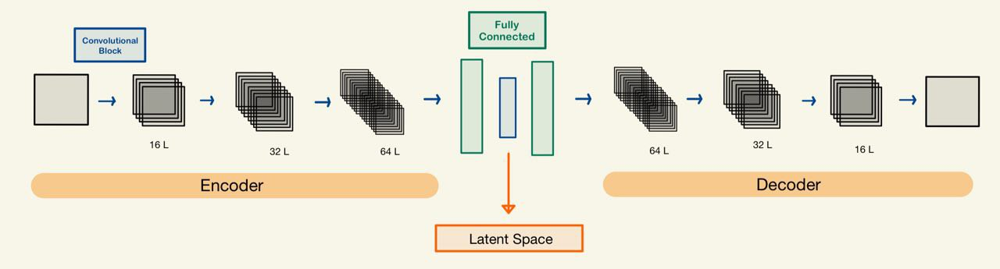

In [ ]:
# ENCODER - DECODER

class Encoder(nn.Module):

    def __init__(self, encoded_space_dim):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = torch.nn.Sequential(
            torch.nn.Conv2d(1, 16, 3, stride=1, padding=1),
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),
            torch.nn.Conv2d(16, 32, 3, stride=1, padding=1),  # b, 8, 3, 3
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),  # b, 8, 2, 2
            torch.nn.Conv2d(32, 64, 3, stride=1, padding=1),  # b, 8, 3, 3
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1)
        )

        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)

        ### Linear section
        self.encoder_lin = nn.Sequential(
            # First linear layer
            nn.Linear(in_features=1000000, out_features=256),
            nn.ReLU(True),
            # nn.Linear(in_features=512, out_features=256),
            # nn.ReLU(True),
            # Second linear layer
            nn.Linear(in_features=256, out_features=encoded_space_dim)


        )

    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        # print(x.shape)
        # Flatten
        x = self.flatten(x)
        # # Apply linear layers
        x = self.encoder_lin(x)
        return x

class Decoder(nn.Module):

  def __init__(self, encoded_space_dim):
      super().__init__()

      ### Linear section
      self.decoder_lin = nn.Sequential(
          # First linear layer
          nn.Linear(in_features=encoded_space_dim, out_features=256),
          nn.ReLU(True),
          # nn.Linear(in_features=256, out_features=512),
          # nn.ReLU(True),
          # Second linear layer
          nn.Linear(in_features=256, out_features=1000000),
          nn.ReLU(True)
      )

      ### Unflatten
      self.unflatten = nn.Unflatten(dim=1, unflattened_size=(64, 125, 125))

      ### Convolutional section
      self.decoder_conv =nn.Sequential(
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(64, 32, 3, stride=1, padding=1),  # b, 16, 10, 10
          torch.nn.ReLU(True),
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(32, 16, 3, stride=1, padding=2),  # b, 16, 10, 10
          torch.nn.ReLU(True),
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(16, 1, 5, stride=1, padding=3)  # b, 8, 3, 3

          # torch.nn.Sigmoid()
      )

  def forward(self, x):
      # Apply linear layers
      x = self.decoder_lin(x)
      # Unflatten
      x = self.unflatten(x)
      # Apply transposed convolutions
      x = self.decoder_conv(x)
      # Apply a sigmoid to force the output to be between 0 and 1 (valid pixel values)
      # x = torch.sigmoid(x)
      return x

---- latent space dimensionality: 4 ----
Selected device: cuda
EPOCH 1/70


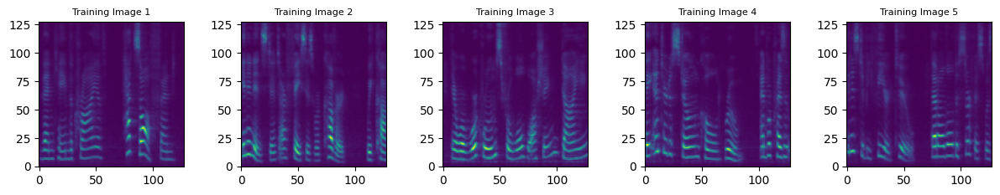

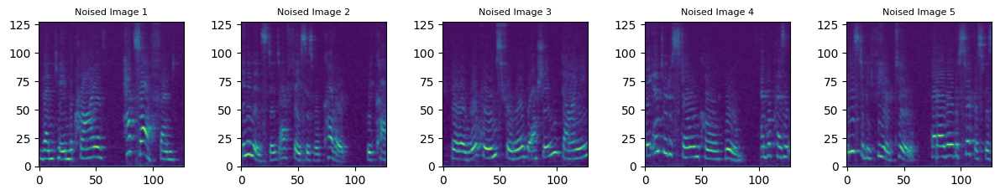

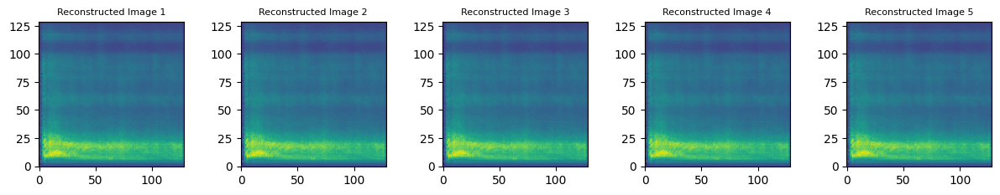

TRAIN - EPOCH 1/70 - loss: 1.2507
VALIDATION - EPOCH 1/70 - loss: 4.2796

EPOCH 2/70
TRAIN - EPOCH 2/70 - loss: 0.4912
VALIDATION - EPOCH 2/70 - loss: 1.7686

EPOCH 3/70
TRAIN - EPOCH 3/70 - loss: 0.3419
VALIDATION - EPOCH 3/70 - loss: 1.1105

EPOCH 4/70
TRAIN - EPOCH 4/70 - loss: 0.2915
VALIDATION - EPOCH 4/70 - loss: 0.8006

EPOCH 5/70
TRAIN - EPOCH 5/70 - loss: 0.2628
VALIDATION - EPOCH 5/70 - loss: 0.6181

EPOCH 6/70
TRAIN - EPOCH 6/70 - loss: 0.2443
VALIDATION - EPOCH 6/70 - loss: 0.5069

EPOCH 7/70
TRAIN - EPOCH 7/70 - loss: 0.2325
VALIDATION - EPOCH 7/70 - loss: 0.4277

EPOCH 8/70
TRAIN - EPOCH 8/70 - loss: 0.2244
VALIDATION - EPOCH 8/70 - loss: 0.3748

EPOCH 9/70
TRAIN - EPOCH 9/70 - loss: 0.2193
VALIDATION - EPOCH 9/70 - loss: 0.3426

EPOCH 10/70
TRAIN - EPOCH 10/70 - loss: 0.2161
VALIDATION - EPOCH 10/70 - loss: 0.3214

EPOCH 11/70
TRAIN - EPOCH 11/70 - loss: 0.2136
VALIDATION - EPOCH 11/70 - loss: 0.2979

EPOCH 12/70
TRAIN - EPOCH 12/70 - loss: 0.2114
VALIDATION - EPOCH 12/7

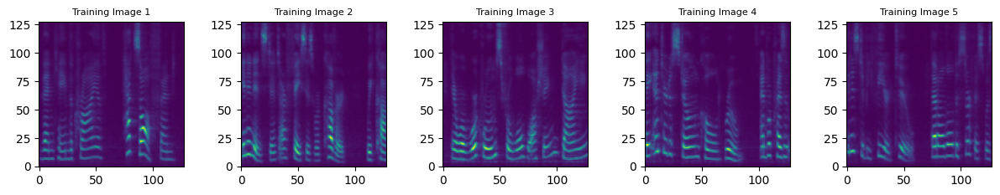

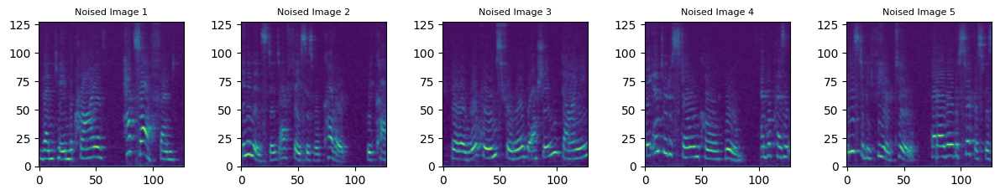

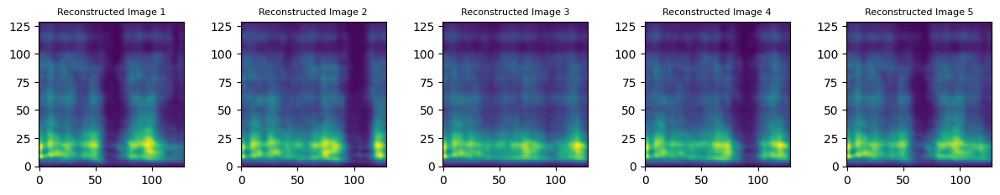

TRAIN - EPOCH 16/70 - loss: 0.2081
VALIDATION - EPOCH 16/70 - loss: 0.2539

EPOCH 17/70
TRAIN - EPOCH 17/70 - loss: 0.2078
VALIDATION - EPOCH 17/70 - loss: 0.2513

EPOCH 18/70
TRAIN - EPOCH 18/70 - loss: 0.2072
VALIDATION - EPOCH 18/70 - loss: 0.2511

EPOCH 19/70
TRAIN - EPOCH 19/70 - loss: 0.2072
VALIDATION - EPOCH 19/70 - loss: 0.2515

EPOCH 20/70
TRAIN - EPOCH 20/70 - loss: 0.2072
VALIDATION - EPOCH 20/70 - loss: 0.2451

EPOCH 21/70
TRAIN - EPOCH 21/70 - loss: 0.2073
VALIDATION - EPOCH 21/70 - loss: 0.2401

EPOCH 22/70
TRAIN - EPOCH 22/70 - loss: 0.2068
VALIDATION - EPOCH 22/70 - loss: 0.2437

EPOCH 23/70
TRAIN - EPOCH 23/70 - loss: 0.2064
VALIDATION - EPOCH 23/70 - loss: 0.2445

EPOCH 24/70
TRAIN - EPOCH 24/70 - loss: 0.2060
VALIDATION - EPOCH 24/70 - loss: 0.2425

EPOCH 25/70
TRAIN - EPOCH 25/70 - loss: 0.2057
VALIDATION - EPOCH 25/70 - loss: 0.2407

EPOCH 26/70
TRAIN - EPOCH 26/70 - loss: 0.2054
VALIDATION - EPOCH 26/70 - loss: 0.2389

EPOCH 27/70
TRAIN - EPOCH 27/70 - loss: 0.20

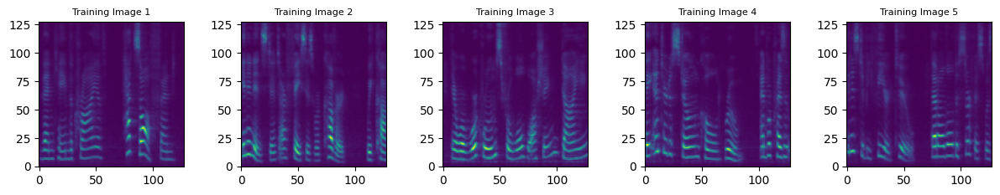

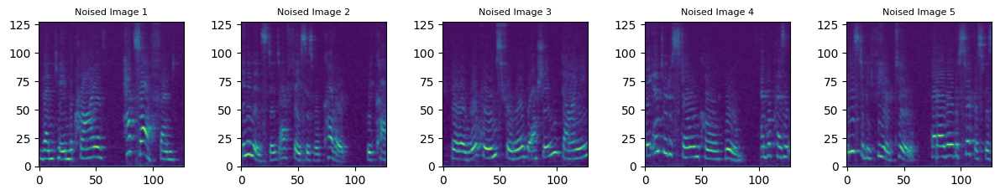

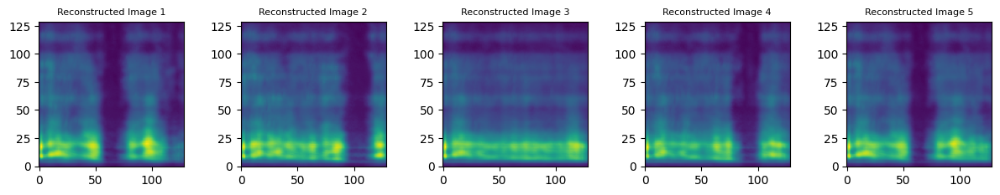

TRAIN - EPOCH 31/70 - loss: 0.2054
VALIDATION - EPOCH 31/70 - loss: 0.2362

EPOCH 32/70
TRAIN - EPOCH 32/70 - loss: 0.2050
VALIDATION - EPOCH 32/70 - loss: 0.2326

EPOCH 33/70
TRAIN - EPOCH 33/70 - loss: 0.2049
VALIDATION - EPOCH 33/70 - loss: 0.2331

EPOCH 34/70
TRAIN - EPOCH 34/70 - loss: 0.2051
VALIDATION - EPOCH 34/70 - loss: 0.2355

EPOCH 35/70
TRAIN - EPOCH 35/70 - loss: 0.2053
VALIDATION - EPOCH 35/70 - loss: 0.2342

EPOCH 36/70
TRAIN - EPOCH 36/70 - loss: 0.2052
VALIDATION - EPOCH 36/70 - loss: 0.2339

EPOCH 37/70
TRAIN - EPOCH 37/70 - loss: 0.2050
VALIDATION - EPOCH 37/70 - loss: 0.2302

EPOCH 38/70
TRAIN - EPOCH 38/70 - loss: 0.2051
VALIDATION - EPOCH 38/70 - loss: 0.2317

EPOCH 39/70
TRAIN - EPOCH 39/70 - loss: 0.2051
VALIDATION - EPOCH 39/70 - loss: 0.2356

EPOCH 40/70
TRAIN - EPOCH 40/70 - loss: 0.2050
VALIDATION - EPOCH 40/70 - loss: 0.2343

EPOCH 41/70
TRAIN - EPOCH 41/70 - loss: 0.2045
VALIDATION - EPOCH 41/70 - loss: 0.2347

EPOCH 42/70
TRAIN - EPOCH 42/70 - loss: 0.20

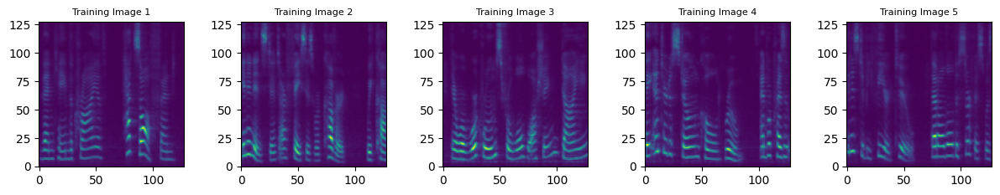

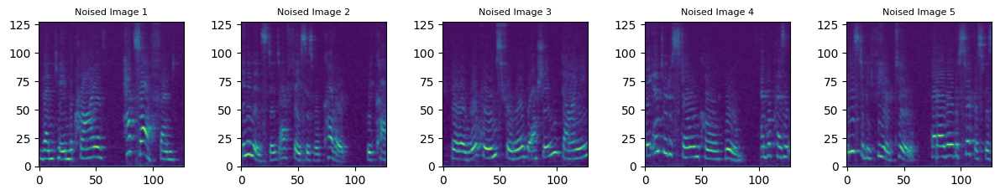

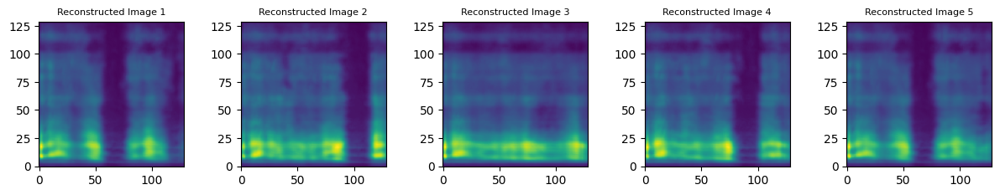

TRAIN - EPOCH 46/70 - loss: 0.2044
VALIDATION - EPOCH 46/70 - loss: 0.2332

EPOCH 47/70
TRAIN - EPOCH 47/70 - loss: 0.2044
VALIDATION - EPOCH 47/70 - loss: 0.2319

EPOCH 48/70
TRAIN - EPOCH 48/70 - loss: 0.2046
VALIDATION - EPOCH 48/70 - loss: 0.2272

EPOCH 49/70
TRAIN - EPOCH 49/70 - loss: 0.2047
VALIDATION - EPOCH 49/70 - loss: 0.2283

EPOCH 50/70
TRAIN - EPOCH 50/70 - loss: 0.2037
VALIDATION - EPOCH 50/70 - loss: 0.2282

EPOCH 51/70
TRAIN - EPOCH 51/70 - loss: 0.2033
VALIDATION - EPOCH 51/70 - loss: 0.2287

EPOCH 52/70
TRAIN - EPOCH 52/70 - loss: 0.2032
VALIDATION - EPOCH 52/70 - loss: 0.2293

EPOCH 53/70
TRAIN - EPOCH 53/70 - loss: 0.2034
VALIDATION - EPOCH 53/70 - loss: 0.2295

EPOCH 54/70
TRAIN - EPOCH 54/70 - loss: 0.2040
VALIDATION - EPOCH 54/70 - loss: 0.2292

EPOCH 55/70
TRAIN - EPOCH 55/70 - loss: 0.2037
VALIDATION - EPOCH 55/70 - loss: 0.2294

EPOCH 56/70
TRAIN - EPOCH 56/70 - loss: 0.2030
VALIDATION - EPOCH 56/70 - loss: 0.2280

EPOCH 57/70
TRAIN - EPOCH 57/70 - loss: 0.20

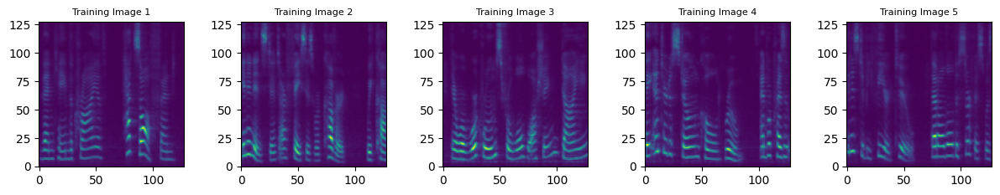

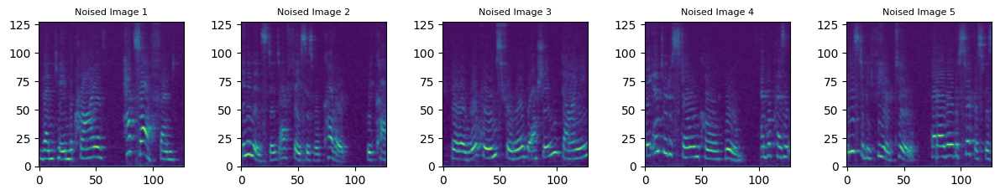

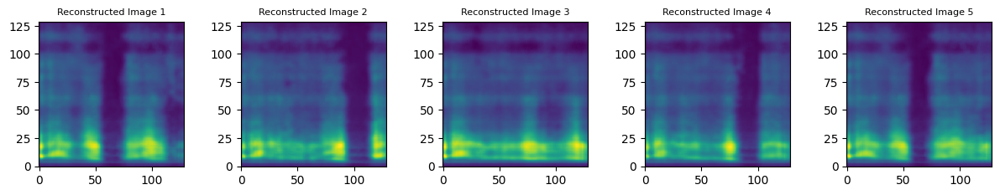

TRAIN - EPOCH 61/70 - loss: 0.2035
VALIDATION - EPOCH 61/70 - loss: 0.2257

EPOCH 62/70
TRAIN - EPOCH 62/70 - loss: 0.2033
VALIDATION - EPOCH 62/70 - loss: 0.2276

EPOCH 63/70
TRAIN - EPOCH 63/70 - loss: 0.2032
VALIDATION - EPOCH 63/70 - loss: 0.2299

EPOCH 64/70
TRAIN - EPOCH 64/70 - loss: 0.2040
VALIDATION - EPOCH 64/70 - loss: 0.2335

EPOCH 65/70
TRAIN - EPOCH 65/70 - loss: 0.2039
VALIDATION - EPOCH 65/70 - loss: 0.2324

EPOCH 66/70
TRAIN - EPOCH 66/70 - loss: 0.2035
VALIDATION - EPOCH 66/70 - loss: 0.2288

EPOCH 67/70
TRAIN - EPOCH 67/70 - loss: 0.2039
VALIDATION - EPOCH 67/70 - loss: 0.2281

EPOCH 68/70
TRAIN - EPOCH 68/70 - loss: 0.2029
VALIDATION - EPOCH 68/70 - loss: 0.2261

EPOCH 69/70
TRAIN - EPOCH 69/70 - loss: 0.2022
VALIDATION - EPOCH 69/70 - loss: 0.2266

EPOCH 70/70
TRAIN - EPOCH 70/70 - loss: 0.2022
VALIDATION - EPOCH 70/70 - loss: 0.2272

---- latent space dimensionality: 32 ----
Selected device: cuda
EPOCH 1/70


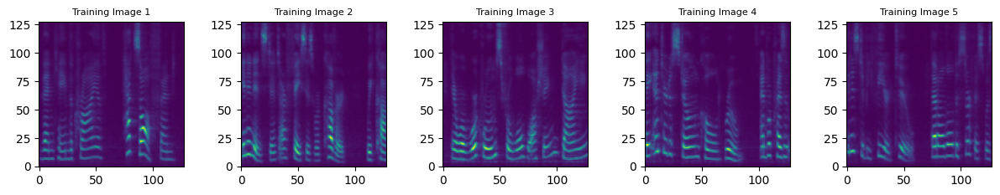

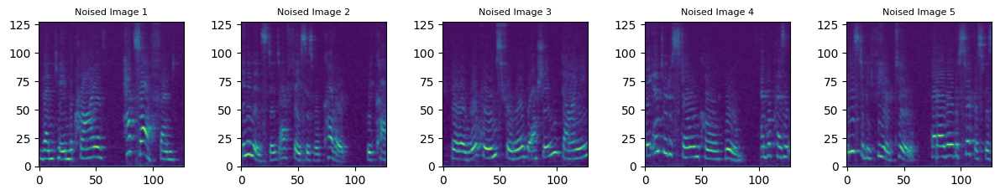

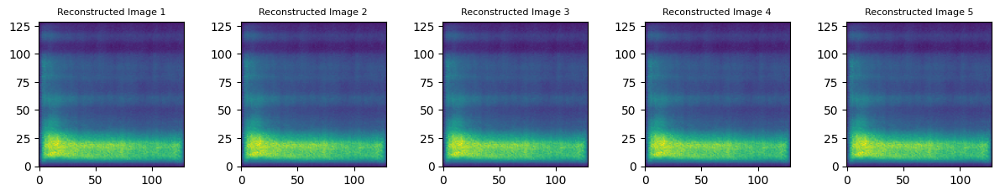

TRAIN - EPOCH 1/70 - loss: 1.4091
VALIDATION - EPOCH 1/70 - loss: 5.2397

EPOCH 2/70
TRAIN - EPOCH 2/70 - loss: 0.5968
VALIDATION - EPOCH 2/70 - loss: 2.6117

EPOCH 3/70
TRAIN - EPOCH 3/70 - loss: 0.4238
VALIDATION - EPOCH 3/70 - loss: 1.7290

EPOCH 4/70
TRAIN - EPOCH 4/70 - loss: 0.3517
VALIDATION - EPOCH 4/70 - loss: 1.2559

EPOCH 5/70
TRAIN - EPOCH 5/70 - loss: 0.3091
VALIDATION - EPOCH 5/70 - loss: 0.9582

EPOCH 6/70
TRAIN - EPOCH 6/70 - loss: 0.2799
VALIDATION - EPOCH 6/70 - loss: 0.7625

EPOCH 7/70
TRAIN - EPOCH 7/70 - loss: 0.2595
VALIDATION - EPOCH 7/70 - loss: 0.6267

EPOCH 8/70
TRAIN - EPOCH 8/70 - loss: 0.2451
VALIDATION - EPOCH 8/70 - loss: 0.5288

EPOCH 9/70
TRAIN - EPOCH 9/70 - loss: 0.2347
VALIDATION - EPOCH 9/70 - loss: 0.4597

EPOCH 10/70
TRAIN - EPOCH 10/70 - loss: 0.2263
VALIDATION - EPOCH 10/70 - loss: 0.4072

EPOCH 11/70
TRAIN - EPOCH 11/70 - loss: 0.2198
VALIDATION - EPOCH 11/70 - loss: 0.3687

EPOCH 12/70
TRAIN - EPOCH 12/70 - loss: 0.2148
VALIDATION - EPOCH 12/7

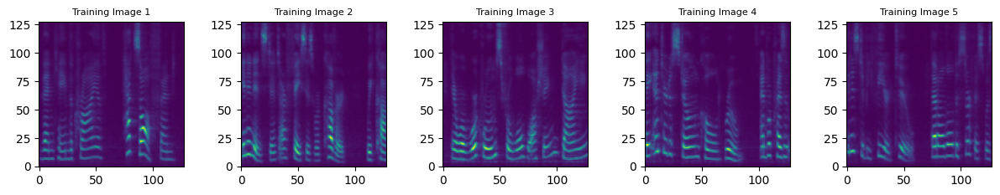

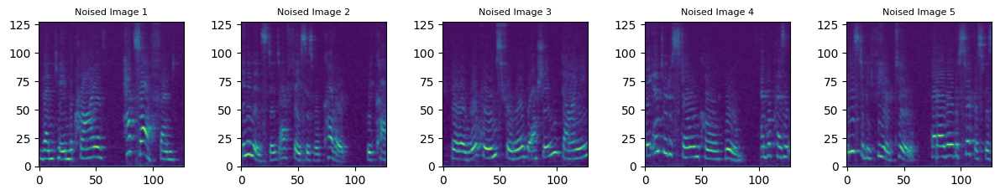

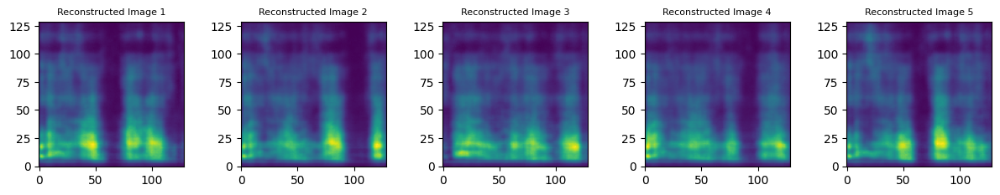

TRAIN - EPOCH 16/70 - loss: 0.2011
VALIDATION - EPOCH 16/70 - loss: 0.2763

EPOCH 17/70
TRAIN - EPOCH 17/70 - loss: 0.1991
VALIDATION - EPOCH 17/70 - loss: 0.2677

EPOCH 18/70
TRAIN - EPOCH 18/70 - loss: 0.1974
VALIDATION - EPOCH 18/70 - loss: 0.2627

EPOCH 19/70
TRAIN - EPOCH 19/70 - loss: 0.1958
VALIDATION - EPOCH 19/70 - loss: 0.2618

EPOCH 20/70
TRAIN - EPOCH 20/70 - loss: 0.1940
VALIDATION - EPOCH 20/70 - loss: 0.2609

EPOCH 21/70
TRAIN - EPOCH 21/70 - loss: 0.1927
VALIDATION - EPOCH 21/70 - loss: 0.2572

EPOCH 22/70
TRAIN - EPOCH 22/70 - loss: 0.1918
VALIDATION - EPOCH 22/70 - loss: 0.2550

EPOCH 23/70
TRAIN - EPOCH 23/70 - loss: 0.1907
VALIDATION - EPOCH 23/70 - loss: 0.2555

EPOCH 24/70
TRAIN - EPOCH 24/70 - loss: 0.1895
VALIDATION - EPOCH 24/70 - loss: 0.2523

EPOCH 25/70
TRAIN - EPOCH 25/70 - loss: 0.1890
VALIDATION - EPOCH 25/70 - loss: 0.2494

EPOCH 26/70
TRAIN - EPOCH 26/70 - loss: 0.1885
VALIDATION - EPOCH 26/70 - loss: 0.2509

EPOCH 27/70
TRAIN - EPOCH 27/70 - loss: 0.18

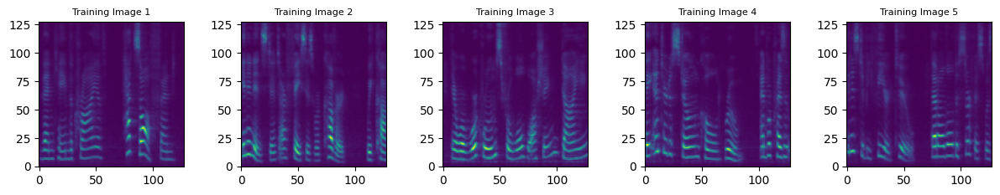

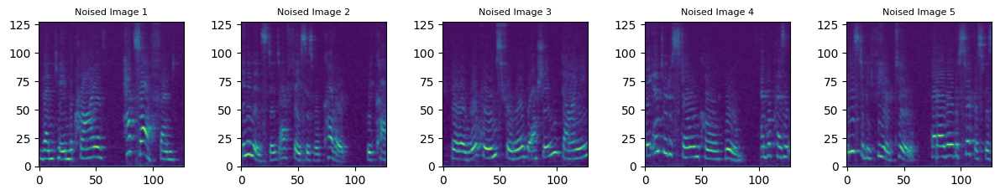

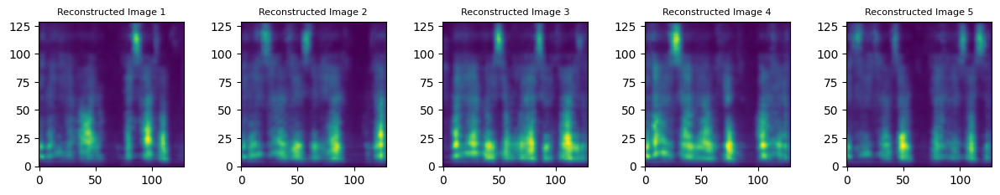

TRAIN - EPOCH 31/70 - loss: 0.1851
VALIDATION - EPOCH 31/70 - loss: 0.2533

EPOCH 32/70
TRAIN - EPOCH 32/70 - loss: 0.1850
VALIDATION - EPOCH 32/70 - loss: 0.2503

EPOCH 33/70
TRAIN - EPOCH 33/70 - loss: 0.1848
VALIDATION - EPOCH 33/70 - loss: 0.2502

EPOCH 34/70
TRAIN - EPOCH 34/70 - loss: 0.1838
VALIDATION - EPOCH 34/70 - loss: 0.2485

EPOCH 35/70
TRAIN - EPOCH 35/70 - loss: 0.1831
VALIDATION - EPOCH 35/70 - loss: 0.2507

EPOCH 36/70
TRAIN - EPOCH 36/70 - loss: 0.1828
VALIDATION - EPOCH 36/70 - loss: 0.2536

EPOCH 37/70
TRAIN - EPOCH 37/70 - loss: 0.1821
VALIDATION - EPOCH 37/70 - loss: 0.2550

EPOCH 38/70
TRAIN - EPOCH 38/70 - loss: 0.1815
VALIDATION - EPOCH 38/70 - loss: 0.2472

EPOCH 39/70
TRAIN - EPOCH 39/70 - loss: 0.1811
VALIDATION - EPOCH 39/70 - loss: 0.2444

EPOCH 40/70
TRAIN - EPOCH 40/70 - loss: 0.1807
VALIDATION - EPOCH 40/70 - loss: 0.2482

EPOCH 41/70
TRAIN - EPOCH 41/70 - loss: 0.1796
VALIDATION - EPOCH 41/70 - loss: 0.2561

EPOCH 42/70
TRAIN - EPOCH 42/70 - loss: 0.17

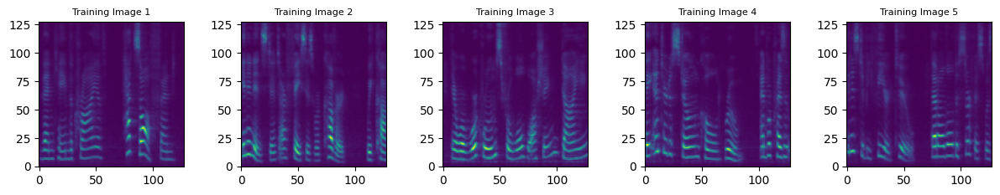

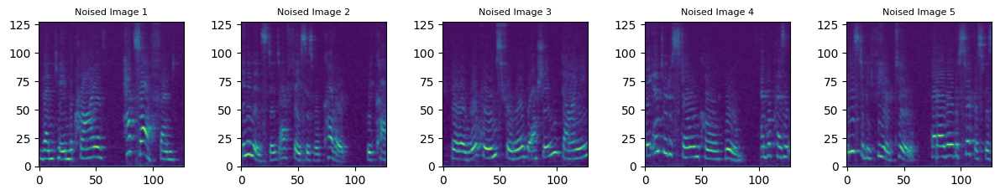

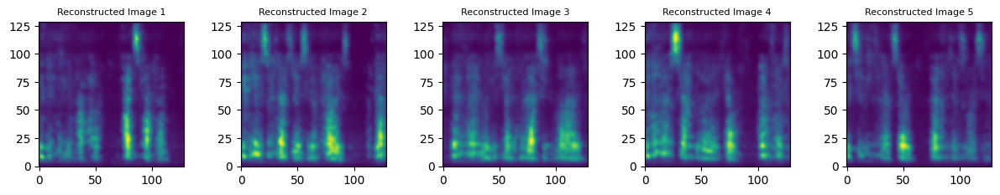

TRAIN - EPOCH 46/70 - loss: 0.1785
VALIDATION - EPOCH 46/70 - loss: 0.2635

EPOCH 47/70
TRAIN - EPOCH 47/70 - loss: 0.1784
VALIDATION - EPOCH 47/70 - loss: 0.2573

EPOCH 48/70
TRAIN - EPOCH 48/70 - loss: 0.1780
VALIDATION - EPOCH 48/70 - loss: 0.2525

EPOCH 49/70
TRAIN - EPOCH 49/70 - loss: 0.1781
VALIDATION - EPOCH 49/70 - loss: 0.2530

EPOCH 50/70
TRAIN - EPOCH 50/70 - loss: 0.1771
VALIDATION - EPOCH 50/70 - loss: 0.2604

EPOCH 51/70
TRAIN - EPOCH 51/70 - loss: 0.1758
VALIDATION - EPOCH 51/70 - loss: 0.2635

EPOCH 52/70
TRAIN - EPOCH 52/70 - loss: 0.1751
VALIDATION - EPOCH 52/70 - loss: 0.2695

EPOCH 53/70
TRAIN - EPOCH 53/70 - loss: 0.1749
VALIDATION - EPOCH 53/70 - loss: 0.2654

EPOCH 54/70
TRAIN - EPOCH 54/70 - loss: 0.1760
VALIDATION - EPOCH 54/70 - loss: 0.2669

EPOCH 55/70
TRAIN - EPOCH 55/70 - loss: 0.1758
VALIDATION - EPOCH 55/70 - loss: 0.2710

EPOCH 56/70
TRAIN - EPOCH 56/70 - loss: 0.1754
VALIDATION - EPOCH 56/70 - loss: 0.2792

EPOCH 57/70
TRAIN - EPOCH 57/70 - loss: 0.17

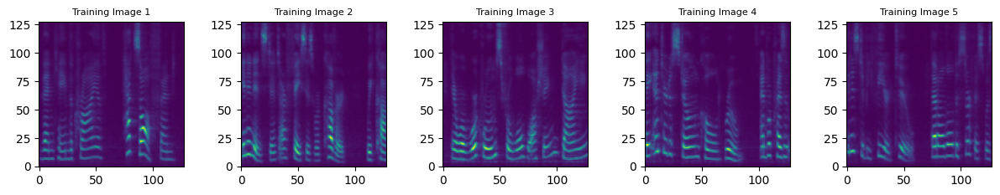

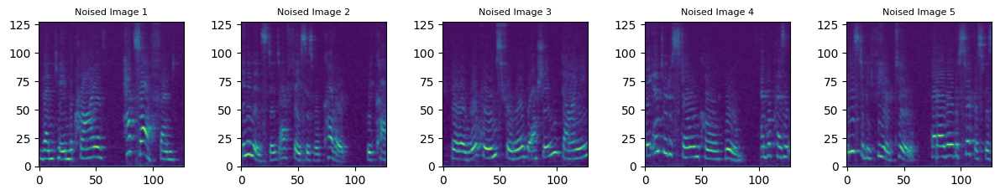

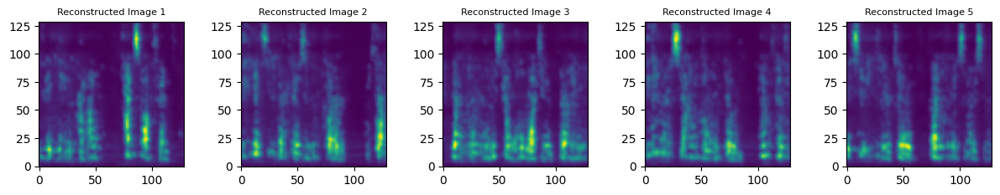

TRAIN - EPOCH 61/70 - loss: 0.1716
VALIDATION - EPOCH 61/70 - loss: 0.2948

EPOCH 62/70
TRAIN - EPOCH 62/70 - loss: 0.1736
VALIDATION - EPOCH 62/70 - loss: 0.2930

EPOCH 63/70
TRAIN - EPOCH 63/70 - loss: 0.1725
VALIDATION - EPOCH 63/70 - loss: 0.2834

EPOCH 64/70
TRAIN - EPOCH 64/70 - loss: 0.1717
VALIDATION - EPOCH 64/70 - loss: 0.2858

EPOCH 65/70
TRAIN - EPOCH 65/70 - loss: 0.1713
VALIDATION - EPOCH 65/70 - loss: 0.2878

EPOCH 66/70
TRAIN - EPOCH 66/70 - loss: 0.1702
VALIDATION - EPOCH 66/70 - loss: 0.2888

EPOCH 67/70
TRAIN - EPOCH 67/70 - loss: 0.1702
VALIDATION - EPOCH 67/70 - loss: 0.2914

EPOCH 68/70
TRAIN - EPOCH 68/70 - loss: 0.1696
VALIDATION - EPOCH 68/70 - loss: 0.2990

EPOCH 69/70
TRAIN - EPOCH 69/70 - loss: 0.1684
VALIDATION - EPOCH 69/70 - loss: 0.3067

EPOCH 70/70
TRAIN - EPOCH 70/70 - loss: 0.1705
VALIDATION - EPOCH 70/70 - loss: 0.3043

---- latent space dimensionality: 128 ----
Selected device: cuda
EPOCH 1/70


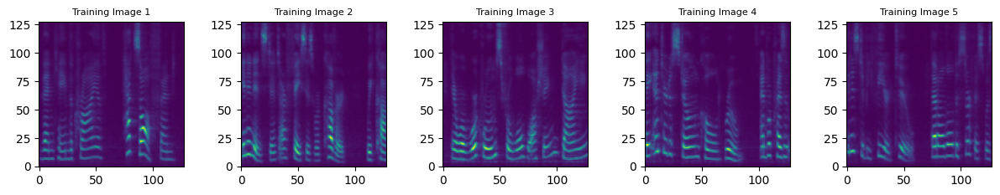

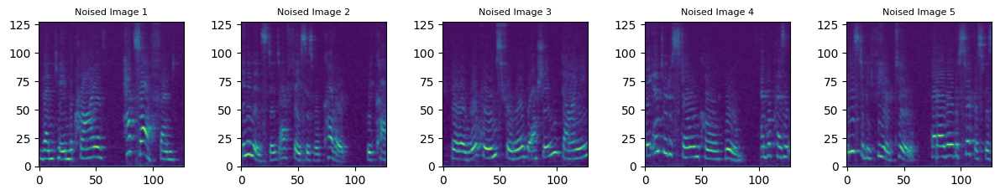

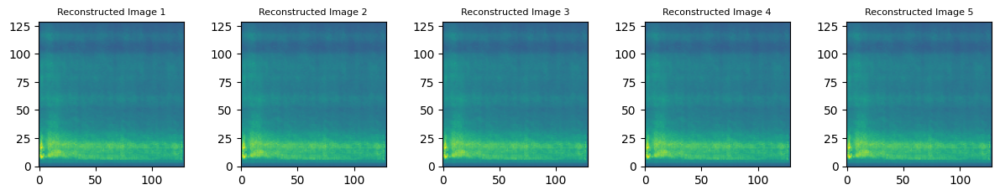

TRAIN - EPOCH 1/70 - loss: 1.0984
VALIDATION - EPOCH 1/70 - loss: 3.1139

EPOCH 2/70
TRAIN - EPOCH 2/70 - loss: 0.3709
VALIDATION - EPOCH 2/70 - loss: 0.8147

EPOCH 3/70
TRAIN - EPOCH 3/70 - loss: 0.2520
VALIDATION - EPOCH 3/70 - loss: 0.4288

EPOCH 4/70
TRAIN - EPOCH 4/70 - loss: 0.2280
VALIDATION - EPOCH 4/70 - loss: 0.3247

EPOCH 5/70
TRAIN - EPOCH 5/70 - loss: 0.2200
VALIDATION - EPOCH 5/70 - loss: 0.2880

EPOCH 6/70
TRAIN - EPOCH 6/70 - loss: 0.2138
VALIDATION - EPOCH 6/70 - loss: 0.2729

EPOCH 7/70
TRAIN - EPOCH 7/70 - loss: 0.2106
VALIDATION - EPOCH 7/70 - loss: 0.2637

EPOCH 8/70
TRAIN - EPOCH 8/70 - loss: 0.2078
VALIDATION - EPOCH 8/70 - loss: 0.2578

EPOCH 9/70
TRAIN - EPOCH 9/70 - loss: 0.2051
VALIDATION - EPOCH 9/70 - loss: 0.2588

EPOCH 10/70
TRAIN - EPOCH 10/70 - loss: 0.2027
VALIDATION - EPOCH 10/70 - loss: 0.2602

EPOCH 11/70
TRAIN - EPOCH 11/70 - loss: 0.1998
VALIDATION - EPOCH 11/70 - loss: 0.2502

EPOCH 12/70
TRAIN - EPOCH 12/70 - loss: 0.1977
VALIDATION - EPOCH 12/7

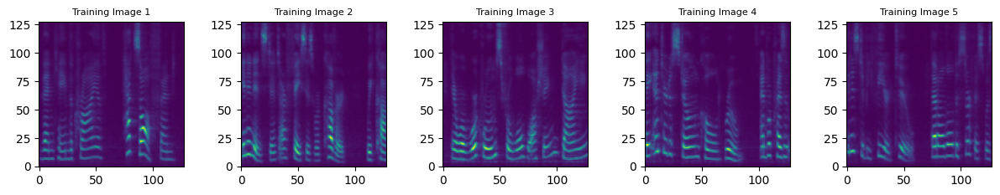

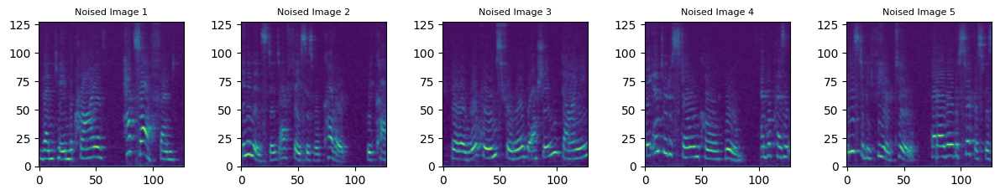

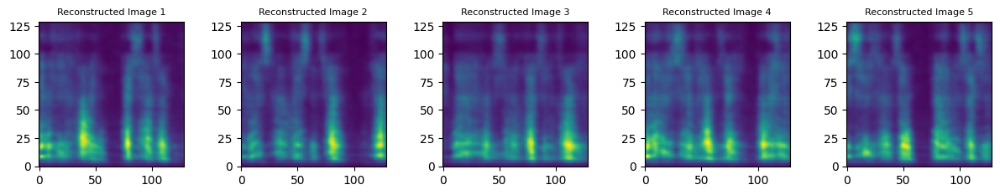

TRAIN - EPOCH 16/70 - loss: 0.1885
VALIDATION - EPOCH 16/70 - loss: 0.2534

EPOCH 17/70
TRAIN - EPOCH 17/70 - loss: 0.1867
VALIDATION - EPOCH 17/70 - loss: 0.2480

EPOCH 18/70
TRAIN - EPOCH 18/70 - loss: 0.1852
VALIDATION - EPOCH 18/70 - loss: 0.2457

EPOCH 19/70
TRAIN - EPOCH 19/70 - loss: 0.1836
VALIDATION - EPOCH 19/70 - loss: 0.2511

EPOCH 20/70
TRAIN - EPOCH 20/70 - loss: 0.1824
VALIDATION - EPOCH 20/70 - loss: 0.2561

EPOCH 21/70
TRAIN - EPOCH 21/70 - loss: 0.1833
VALIDATION - EPOCH 21/70 - loss: 0.2546

EPOCH 22/70
TRAIN - EPOCH 22/70 - loss: 0.1805
VALIDATION - EPOCH 22/70 - loss: 0.2463

EPOCH 23/70
TRAIN - EPOCH 23/70 - loss: 0.1791
VALIDATION - EPOCH 23/70 - loss: 0.2401

EPOCH 24/70
TRAIN - EPOCH 24/70 - loss: 0.1785
VALIDATION - EPOCH 24/70 - loss: 0.2414

EPOCH 25/70
TRAIN - EPOCH 25/70 - loss: 0.1772
VALIDATION - EPOCH 25/70 - loss: 0.2459

EPOCH 26/70
TRAIN - EPOCH 26/70 - loss: 0.1758
VALIDATION - EPOCH 26/70 - loss: 0.2513

EPOCH 27/70
TRAIN - EPOCH 27/70 - loss: 0.17

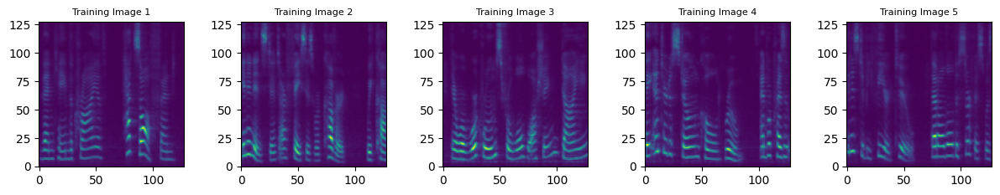

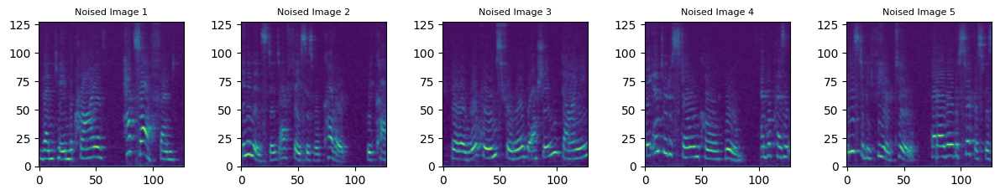

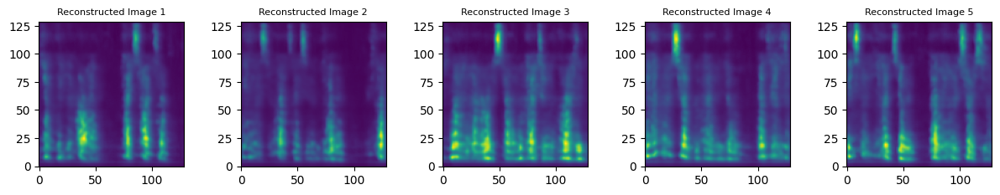

TRAIN - EPOCH 31/70 - loss: 0.1744
VALIDATION - EPOCH 31/70 - loss: 0.2424

EPOCH 32/70
TRAIN - EPOCH 32/70 - loss: 0.1726
VALIDATION - EPOCH 32/70 - loss: 0.2431

EPOCH 33/70
TRAIN - EPOCH 33/70 - loss: 0.1710
VALIDATION - EPOCH 33/70 - loss: 0.2455

EPOCH 34/70
TRAIN - EPOCH 34/70 - loss: 0.1709
VALIDATION - EPOCH 34/70 - loss: 0.2527

EPOCH 35/70
TRAIN - EPOCH 35/70 - loss: 0.1714
VALIDATION - EPOCH 35/70 - loss: 0.2604

EPOCH 36/70
TRAIN - EPOCH 36/70 - loss: 0.1706
VALIDATION - EPOCH 36/70 - loss: 0.2644

EPOCH 37/70
TRAIN - EPOCH 37/70 - loss: 0.1704
VALIDATION - EPOCH 37/70 - loss: 0.2541

EPOCH 38/70
TRAIN - EPOCH 38/70 - loss: 0.1696
VALIDATION - EPOCH 38/70 - loss: 0.2501

EPOCH 39/70
TRAIN - EPOCH 39/70 - loss: 0.1676
VALIDATION - EPOCH 39/70 - loss: 0.2544

EPOCH 40/70
TRAIN - EPOCH 40/70 - loss: 0.1673
VALIDATION - EPOCH 40/70 - loss: 0.2621

EPOCH 41/70
TRAIN - EPOCH 41/70 - loss: 0.1672
VALIDATION - EPOCH 41/70 - loss: 0.2684

EPOCH 42/70
TRAIN - EPOCH 42/70 - loss: 0.16

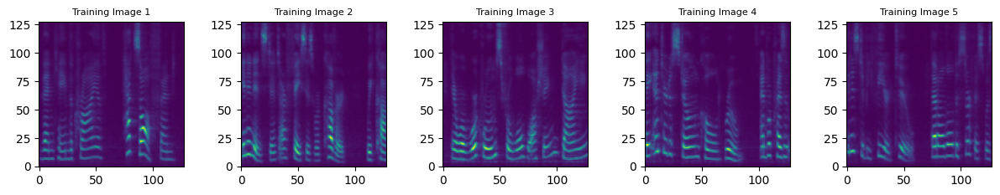

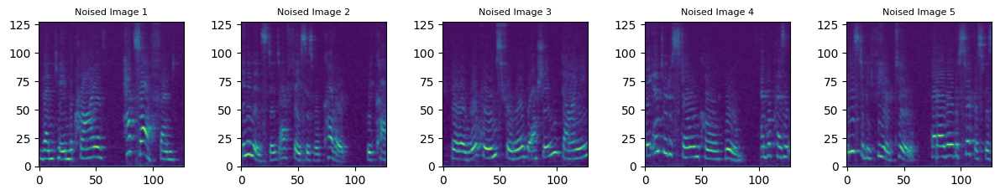

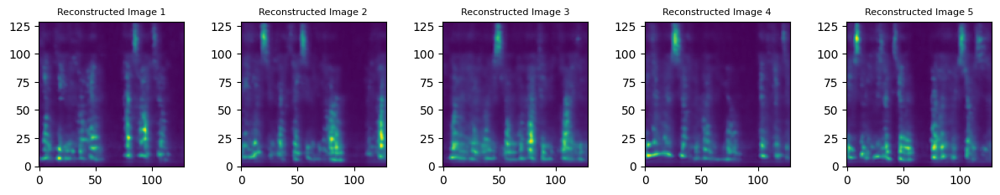

TRAIN - EPOCH 46/70 - loss: 0.1653
VALIDATION - EPOCH 46/70 - loss: 0.2643

EPOCH 47/70
TRAIN - EPOCH 47/70 - loss: 0.1644
VALIDATION - EPOCH 47/70 - loss: 0.2690

EPOCH 48/70
TRAIN - EPOCH 48/70 - loss: 0.1645
VALIDATION - EPOCH 48/70 - loss: 0.2695

EPOCH 49/70
TRAIN - EPOCH 49/70 - loss: 0.1639
VALIDATION - EPOCH 49/70 - loss: 0.2698

EPOCH 50/70
TRAIN - EPOCH 50/70 - loss: 0.1641
VALIDATION - EPOCH 50/70 - loss: 0.2662

EPOCH 51/70
TRAIN - EPOCH 51/70 - loss: 0.1650
VALIDATION - EPOCH 51/70 - loss: 0.2749

EPOCH 52/70
TRAIN - EPOCH 52/70 - loss: 0.1641
VALIDATION - EPOCH 52/70 - loss: 0.2799

EPOCH 53/70
TRAIN - EPOCH 53/70 - loss: 0.1621
VALIDATION - EPOCH 53/70 - loss: 0.2834

EPOCH 54/70
TRAIN - EPOCH 54/70 - loss: 0.1625
VALIDATION - EPOCH 54/70 - loss: 0.2798

EPOCH 55/70
TRAIN - EPOCH 55/70 - loss: 0.1630
VALIDATION - EPOCH 55/70 - loss: 0.2700

EPOCH 56/70
TRAIN - EPOCH 56/70 - loss: 0.1626
VALIDATION - EPOCH 56/70 - loss: 0.2757

EPOCH 57/70
TRAIN - EPOCH 57/70 - loss: 0.16

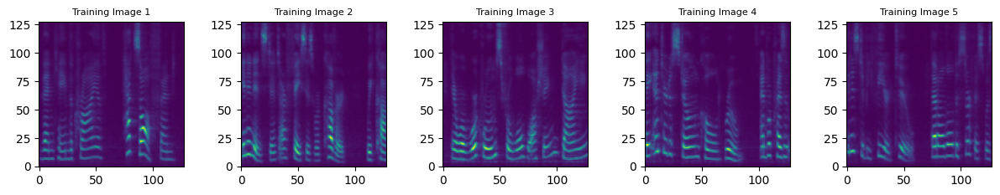

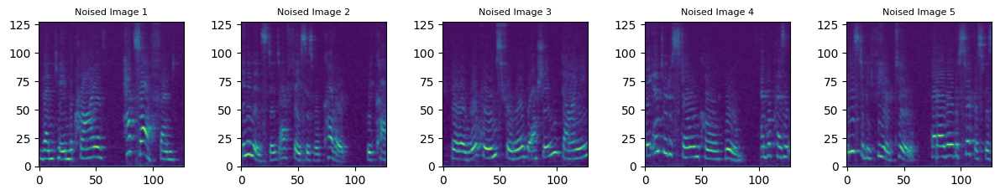

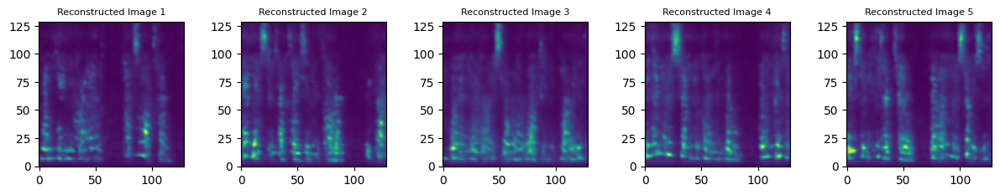

TRAIN - EPOCH 61/70 - loss: 0.1608
VALIDATION - EPOCH 61/70 - loss: 0.2988

EPOCH 62/70
TRAIN - EPOCH 62/70 - loss: 0.1630
VALIDATION - EPOCH 62/70 - loss: 0.2823

EPOCH 63/70
TRAIN - EPOCH 63/70 - loss: 0.1617
VALIDATION - EPOCH 63/70 - loss: 0.2765

EPOCH 64/70
TRAIN - EPOCH 64/70 - loss: 0.1594
VALIDATION - EPOCH 64/70 - loss: 0.2882

EPOCH 65/70
TRAIN - EPOCH 65/70 - loss: 0.1581
VALIDATION - EPOCH 65/70 - loss: 0.2994

EPOCH 66/70
TRAIN - EPOCH 66/70 - loss: 0.1586
VALIDATION - EPOCH 66/70 - loss: 0.3047

EPOCH 67/70
TRAIN - EPOCH 67/70 - loss: 0.1573
VALIDATION - EPOCH 67/70 - loss: 0.2973

EPOCH 68/70
TRAIN - EPOCH 68/70 - loss: 0.1570
VALIDATION - EPOCH 68/70 - loss: 0.2949

EPOCH 69/70
TRAIN - EPOCH 69/70 - loss: 0.1586
VALIDATION - EPOCH 69/70 - loss: 0.3056

EPOCH 70/70
TRAIN - EPOCH 70/70 - loss: 0.1592
VALIDATION - EPOCH 70/70 - loss: 0.3046

---- latent space dimensionality: 512 ----
Selected device: cuda
EPOCH 1/70


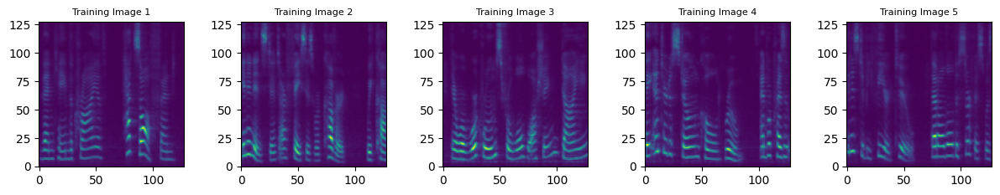

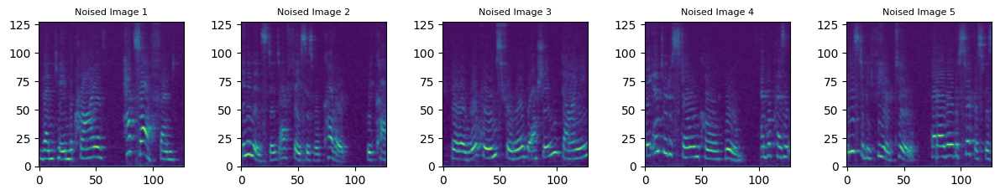

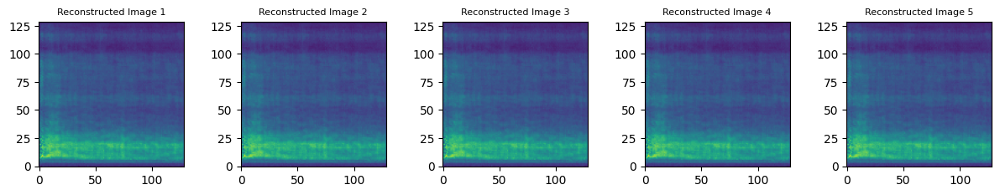

TRAIN - EPOCH 1/70 - loss: 1.1164
VALIDATION - EPOCH 1/70 - loss: 3.2070

EPOCH 2/70
TRAIN - EPOCH 2/70 - loss: 0.3860
VALIDATION - EPOCH 2/70 - loss: 0.9792

EPOCH 3/70
TRAIN - EPOCH 3/70 - loss: 0.2675
VALIDATION - EPOCH 3/70 - loss: 0.5558

EPOCH 4/70
TRAIN - EPOCH 4/70 - loss: 0.2387
VALIDATION - EPOCH 4/70 - loss: 0.4095

EPOCH 5/70
TRAIN - EPOCH 5/70 - loss: 0.2256
VALIDATION - EPOCH 5/70 - loss: 0.3382

EPOCH 6/70
TRAIN - EPOCH 6/70 - loss: 0.2189
VALIDATION - EPOCH 6/70 - loss: 0.3041

EPOCH 7/70
TRAIN - EPOCH 7/70 - loss: 0.2153
VALIDATION - EPOCH 7/70 - loss: 0.2836

EPOCH 8/70
TRAIN - EPOCH 8/70 - loss: 0.2114
VALIDATION - EPOCH 8/70 - loss: 0.2722

EPOCH 9/70
TRAIN - EPOCH 9/70 - loss: 0.2096
VALIDATION - EPOCH 9/70 - loss: 0.2658

EPOCH 10/70
TRAIN - EPOCH 10/70 - loss: 0.2078
VALIDATION - EPOCH 10/70 - loss: 0.2633

EPOCH 11/70
TRAIN - EPOCH 11/70 - loss: 0.2066
VALIDATION - EPOCH 11/70 - loss: 0.2534

EPOCH 12/70
TRAIN - EPOCH 12/70 - loss: 0.2053
VALIDATION - EPOCH 12/7

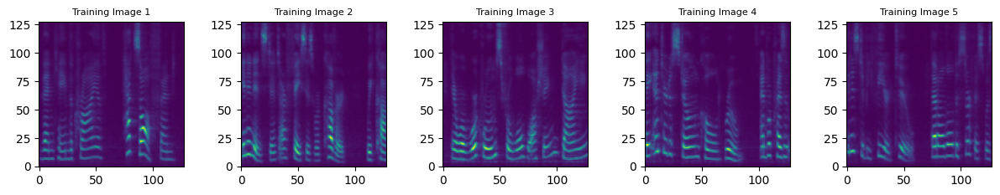

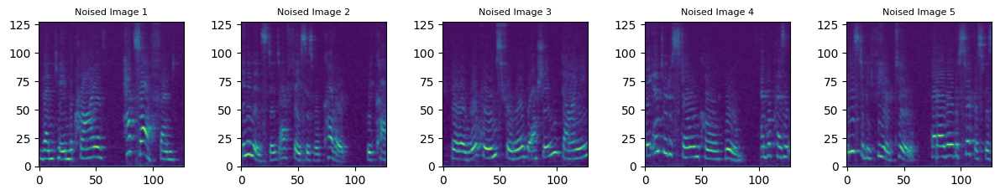

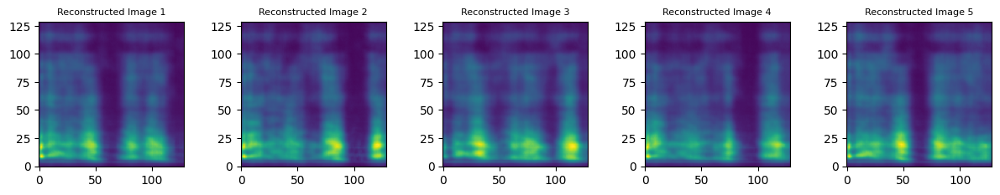

TRAIN - EPOCH 16/70 - loss: 0.1991
VALIDATION - EPOCH 16/70 - loss: 0.2421

EPOCH 17/70
TRAIN - EPOCH 17/70 - loss: 0.1981
VALIDATION - EPOCH 17/70 - loss: 0.2478

EPOCH 18/70
TRAIN - EPOCH 18/70 - loss: 0.1959
VALIDATION - EPOCH 18/70 - loss: 0.2469

EPOCH 19/70
TRAIN - EPOCH 19/70 - loss: 0.1940
VALIDATION - EPOCH 19/70 - loss: 0.2462

EPOCH 20/70
TRAIN - EPOCH 20/70 - loss: 0.1928
VALIDATION - EPOCH 20/70 - loss: 0.2412

EPOCH 21/70
TRAIN - EPOCH 21/70 - loss: 0.1918
VALIDATION - EPOCH 21/70 - loss: 0.2443

EPOCH 22/70
TRAIN - EPOCH 22/70 - loss: 0.1904
VALIDATION - EPOCH 22/70 - loss: 0.2476

EPOCH 23/70
TRAIN - EPOCH 23/70 - loss: 0.1896
VALIDATION - EPOCH 23/70 - loss: 0.2519

EPOCH 24/70
TRAIN - EPOCH 24/70 - loss: 0.1885
VALIDATION - EPOCH 24/70 - loss: 0.2420

EPOCH 25/70
TRAIN - EPOCH 25/70 - loss: 0.1883
VALIDATION - EPOCH 25/70 - loss: 0.2347

EPOCH 26/70
TRAIN - EPOCH 26/70 - loss: 0.1876
VALIDATION - EPOCH 26/70 - loss: 0.2334

EPOCH 27/70
TRAIN - EPOCH 27/70 - loss: 0.18

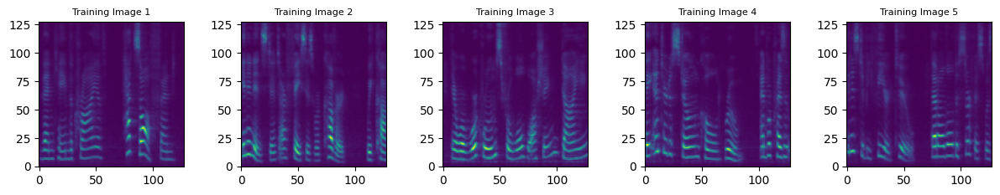

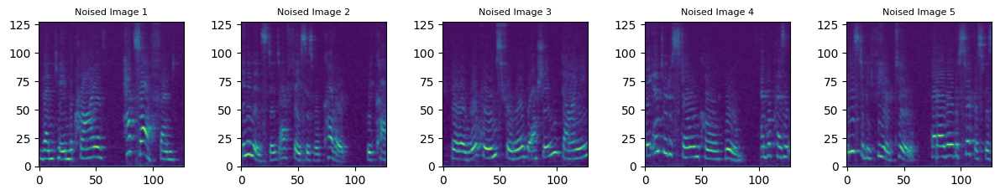

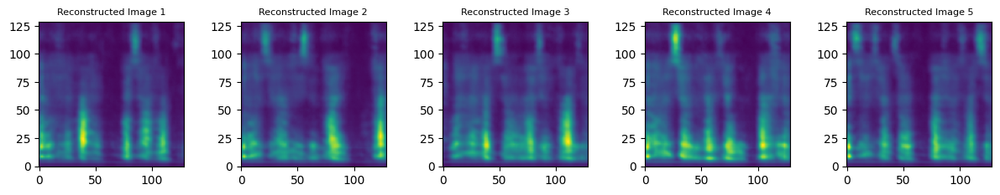

TRAIN - EPOCH 31/70 - loss: 0.1824
VALIDATION - EPOCH 31/70 - loss: 0.2421

EPOCH 32/70
TRAIN - EPOCH 32/70 - loss: 0.1822
VALIDATION - EPOCH 32/70 - loss: 0.2348

EPOCH 33/70
TRAIN - EPOCH 33/70 - loss: 0.1825
VALIDATION - EPOCH 33/70 - loss: 0.2294

EPOCH 34/70
TRAIN - EPOCH 34/70 - loss: 0.1807
VALIDATION - EPOCH 34/70 - loss: 0.2320

EPOCH 35/70
TRAIN - EPOCH 35/70 - loss: 0.1801
VALIDATION - EPOCH 35/70 - loss: 0.2370

EPOCH 36/70
TRAIN - EPOCH 36/70 - loss: 0.1794
VALIDATION - EPOCH 36/70 - loss: 0.2395

EPOCH 37/70
TRAIN - EPOCH 37/70 - loss: 0.1794
VALIDATION - EPOCH 37/70 - loss: 0.2435

EPOCH 38/70
TRAIN - EPOCH 38/70 - loss: 0.1792
VALIDATION - EPOCH 38/70 - loss: 0.2438

EPOCH 39/70
TRAIN - EPOCH 39/70 - loss: 0.1792
VALIDATION - EPOCH 39/70 - loss: 0.2372

EPOCH 40/70
TRAIN - EPOCH 40/70 - loss: 0.1787
VALIDATION - EPOCH 40/70 - loss: 0.2394

EPOCH 41/70
TRAIN - EPOCH 41/70 - loss: 0.1787
VALIDATION - EPOCH 41/70 - loss: 0.2458

EPOCH 42/70
TRAIN - EPOCH 42/70 - loss: 0.17

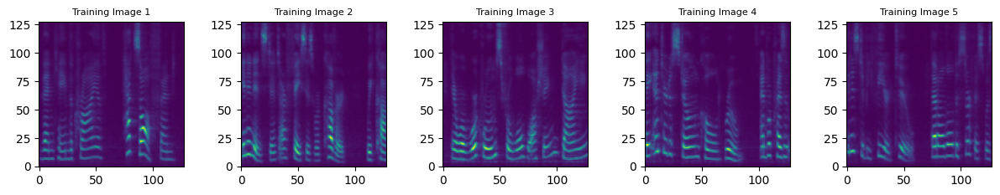

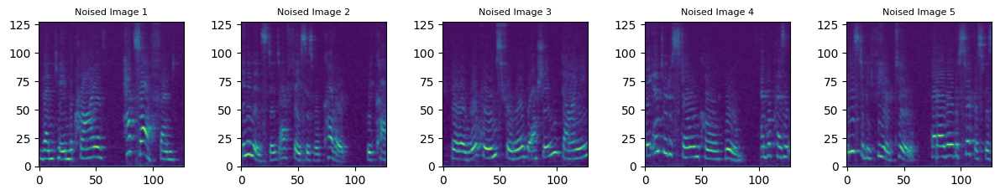

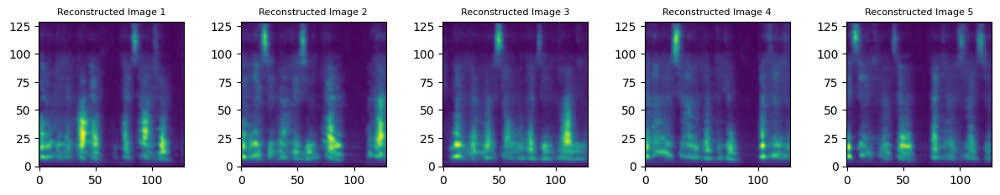

TRAIN - EPOCH 46/70 - loss: 0.1758
VALIDATION - EPOCH 46/70 - loss: 0.2436

EPOCH 47/70
TRAIN - EPOCH 47/70 - loss: 0.1744
VALIDATION - EPOCH 47/70 - loss: 0.2390

EPOCH 48/70
TRAIN - EPOCH 48/70 - loss: 0.1738
VALIDATION - EPOCH 48/70 - loss: 0.2405

EPOCH 49/70
TRAIN - EPOCH 49/70 - loss: 0.1744
VALIDATION - EPOCH 49/70 - loss: 0.2468

EPOCH 50/70
TRAIN - EPOCH 50/70 - loss: 0.1743
VALIDATION - EPOCH 50/70 - loss: 0.2454

EPOCH 51/70
TRAIN - EPOCH 51/70 - loss: 0.1737
VALIDATION - EPOCH 51/70 - loss: 0.2487

EPOCH 52/70
TRAIN - EPOCH 52/70 - loss: 0.1739
VALIDATION - EPOCH 52/70 - loss: 0.2482

EPOCH 53/70
TRAIN - EPOCH 53/70 - loss: 0.1745
VALIDATION - EPOCH 53/70 - loss: 0.2559

EPOCH 54/70
TRAIN - EPOCH 54/70 - loss: 0.1747
VALIDATION - EPOCH 54/70 - loss: 0.2576

EPOCH 55/70
TRAIN - EPOCH 55/70 - loss: 0.1740
VALIDATION - EPOCH 55/70 - loss: 0.2541

EPOCH 56/70
TRAIN - EPOCH 56/70 - loss: 0.1726
VALIDATION - EPOCH 56/70 - loss: 0.2590

EPOCH 57/70
TRAIN - EPOCH 57/70 - loss: 0.17

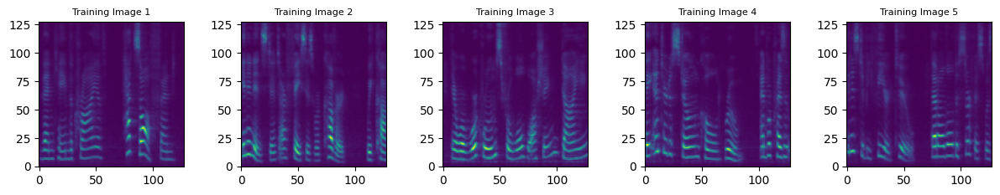

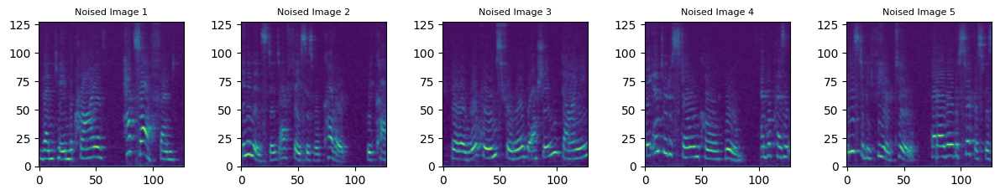

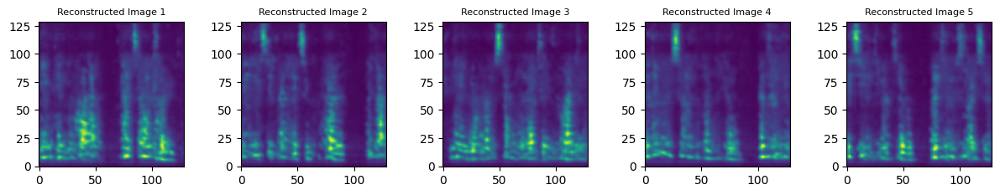

TRAIN - EPOCH 61/70 - loss: 0.1734
VALIDATION - EPOCH 61/70 - loss: 0.2594

EPOCH 62/70
TRAIN - EPOCH 62/70 - loss: 0.1734
VALIDATION - EPOCH 62/70 - loss: 0.2519

EPOCH 63/70
TRAIN - EPOCH 63/70 - loss: 0.1715
VALIDATION - EPOCH 63/70 - loss: 0.2559

EPOCH 64/70
TRAIN - EPOCH 64/70 - loss: 0.1702
VALIDATION - EPOCH 64/70 - loss: 0.2610

EPOCH 65/70
TRAIN - EPOCH 65/70 - loss: 0.1685
VALIDATION - EPOCH 65/70 - loss: 0.2688

EPOCH 66/70
TRAIN - EPOCH 66/70 - loss: 0.1686
VALIDATION - EPOCH 66/70 - loss: 0.2768

EPOCH 67/70
TRAIN - EPOCH 67/70 - loss: 0.1682
VALIDATION - EPOCH 67/70 - loss: 0.2794

EPOCH 68/70
TRAIN - EPOCH 68/70 - loss: 0.1684
VALIDATION - EPOCH 68/70 - loss: 0.2724

EPOCH 69/70
TRAIN - EPOCH 69/70 - loss: 0.1689
VALIDATION - EPOCH 69/70 - loss: 0.2661

EPOCH 70/70
TRAIN - EPOCH 70/70 - loss: 0.1694
VALIDATION - EPOCH 70/70 - loss: 0.2674



In [ ]:
# Latent dimensions
latents = [4, 32, 128, 512]
num_epochs = 70
training_curves, validation_curves = np.zeros((len(latents), num_epochs)), np.zeros((len(latents), num_epochs))

for i, z in enumerate(latents):
  # clear_output(wait=True)
  print(f'---- latent space dimensionality: {z} ----')
  ### Initialize the two networks
  encoded_space_dim = z
  encoder = Encoder(encoded_space_dim=encoded_space_dim)
  decoder = Decoder(encoded_space_dim=encoded_space_dim)

  ### Define the loss function
  loss_fn = torch.nn.L1Loss()

  ### Define an optimizer (both for the encoder and the decoder!)
  lr = 5e-4 # Learning rate
  params_to_optimize = [
      {'params': encoder.parameters()},
      {'params': decoder.parameters(), "lr": 0.001}
  ]
  weight_decay = 1e-5
  optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=weight_decay)

  # Check if the GPU is available
  device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
  print(f'Selected device: {device}')

  # Move both the encoder and the decoder to the selected device
  encoder.to(device)
  decoder.to(device)


  TS, VS = [], []
  ### Training cycle
  # num_epochs
  for epoch in range(num_epochs):
      print('EPOCH %d/%d' % (epoch + 1, num_epochs))

      ### Training (use the training function)
      train_loss = train_epoch(
          encoder=encoder,
          decoder=decoder,
          device=device,
          dataloader=dataloader,
          dataloader_noised=dataloader_noised,
          loss_fn=loss_fn,
          optimizer=optim,
          k=epoch,
          weight_decay=weight_decay,
          visualize=True)
      print(f'TRAIN - EPOCH {epoch+1}/{num_epochs} - loss: {train_loss:.4f}')
      training_curves[i, epoch] = train_loss

      ### Validation  (use the testing function)
      val_loss = test_epoch(
          encoder=encoder,
          decoder=decoder,
          device=device,
          dataloader=test_dataloader,
          dataloader_noised=test_dataloader_noised,
          loss_fn=loss_fn,
          weight_decay=weight_decay)
      # Print Validationloss
      print(f'VALIDATION - EPOCH {epoch+1}/{num_epochs} - loss: {val_loss:.4f}\n')
      validation_curves[i, epoch] = val_loss.item()

In [ ]:
training_curves_copy = training_curves.copy()
validation_curves_copy = validation_curves.copy()

In [ ]:
training_curves_copy = np.load("/content/drive/MyDrive/NNDL/training curves.npy")
validation_curves_copy = np.load("/content/drive/MyDrive/NNDL/validation curves.npy")
latents = [4, 32, 128, 512]
num_epochs = 70

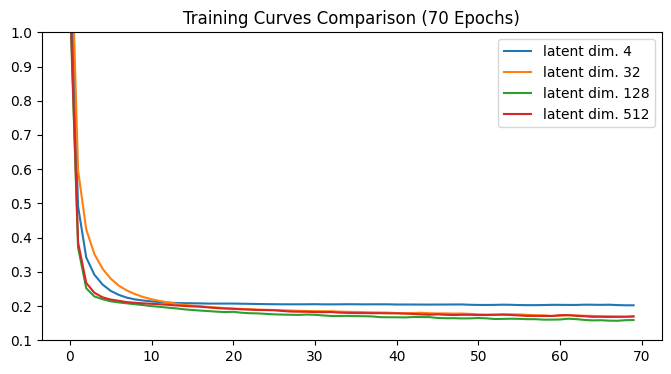

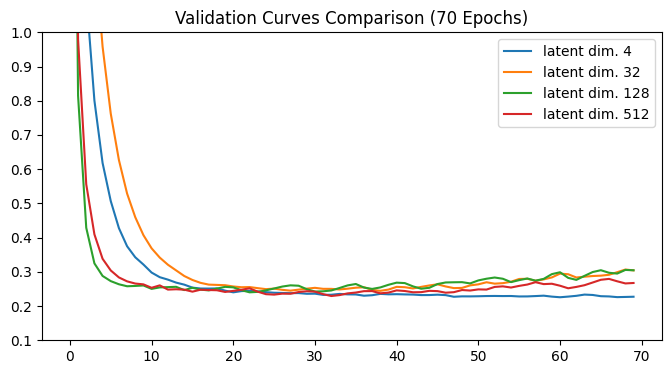

In [ ]:
# training
plt.figure(figsize=(8,4))
for i, z in enumerate(latents):
  plt.plot(training_curves_copy[i,:], label=f'latent dim. {latents[i]}')
plt.ylim(0.1,1)
plt.title(f'Training Curves Comparison ({num_epochs} Epochs)')
plt.legend();
# validation
plt.figure(figsize=(8,4))
for i, z in enumerate(latents):
  plt.plot(validation_curves_copy[i,:], label=f'latent dim. {latents[i]}')
plt.ylim(0.1,1)
plt.title(f'Validation Curves Comparison ({num_epochs} Epochs)')
plt.legend();

Both the validation and training errors were computed using the Mean Absolute Error. From the comparison of the validation results, several conclusions can be drawn. According to the metric, the algorithm performs sufficiently well with the test set, regardless of the latent space dimension. However, it is noteworthy that as the dimension increases, the autoencoder enhances its recognition capabilities, and overfitting becomes more pronounced after a certain number of epochs. It can be observed that the validation curve with z>4 ascends with an increasing number of steps, while the training curve has stabilized.

In [ ]:
# save arrays
np.save("/content/drive/MyDrive/NNDL/training curves.npy", training_curves_copy)
np.save("/content/drive/MyDrive/NNDL/validation curves.npy", validation_curves_copy)
print(f'files loaded!')

files loaded!


------------------------------------------------------------------------------------------

# Model 2

Only convolutioinal

In [ ]:
# ENCODER - DECODER

class Encoder(nn.Module):

    def __init__(self):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = torch.nn.Sequential(
            torch.nn.Conv2d(1, 16, 3, stride=1, padding=1),
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),
            torch.nn.Conv2d(16, 32, 3, stride=1, padding=1),  # b, 8, 3, 3
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),  # b, 8, 2, 2
            torch.nn.Conv2d(32, 64, 3, stride=1, padding=1),  # b, 8, 3, 3
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1)
        )

    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        return x

class Decoder(nn.Module):

  def __init__(self):
      super().__init__()

      ### Convolutional section
      self.decoder_conv =nn.Sequential(
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(64, 32, 3, stride=1, padding=1),  # b, 16, 10, 10
          torch.nn.ReLU(True),
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(32, 16, 3, stride=1, padding=2),  # b, 16, 10, 10
          torch.nn.ReLU(True),
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(16, 1, 5, stride=1, padding=3)  # b, 8, 3, 3

          # torch.nn.Sigmoid()
      )

  def forward(self, x):
      # Apply transposed convolutions
      x = self.decoder_conv(x)
      return x

Selected device: cuda
EPOCH 1/76


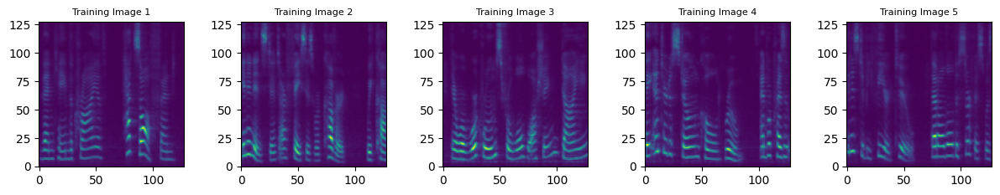

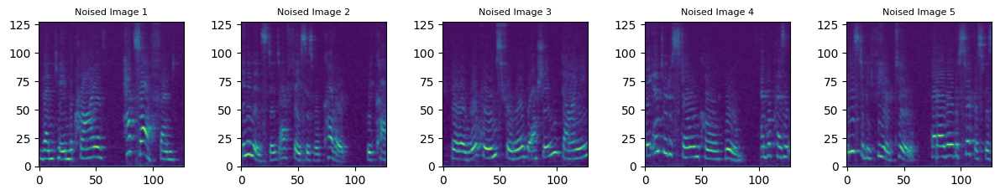

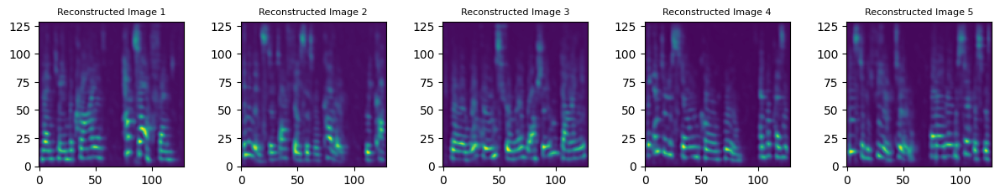

TRAIN - EPOCH 1/76 - loss: 0.1657
VALIDATION - EPOCH 1/76 - loss: 0.2088

--------------------------------------------------------------------------------
EPOCH 2/76
TRAIN - EPOCH 2/76 - loss: 0.1184
VALIDATION - EPOCH 2/76 - loss: 0.2100

--------------------------------------------------------------------------------
EPOCH 3/76
TRAIN - EPOCH 3/76 - loss: 0.1102
VALIDATION - EPOCH 3/76 - loss: 0.2007

--------------------------------------------------------------------------------
EPOCH 4/76
TRAIN - EPOCH 4/76 - loss: 0.1072
VALIDATION - EPOCH 4/76 - loss: 0.2018

--------------------------------------------------------------------------------
EPOCH 5/76
TRAIN - EPOCH 5/76 - loss: 0.1055
VALIDATION - EPOCH 5/76 - loss: 0.2017

--------------------------------------------------------------------------------
EPOCH 6/76
TRAIN - EPOCH 6/76 - loss: 0.1036
VALIDATION - EPOCH 6/76 - loss: 0.2010

--------------------------------------------------------------------------------
EPOCH 7/76
TRAI

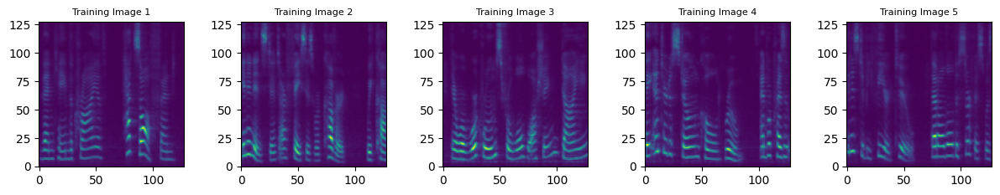

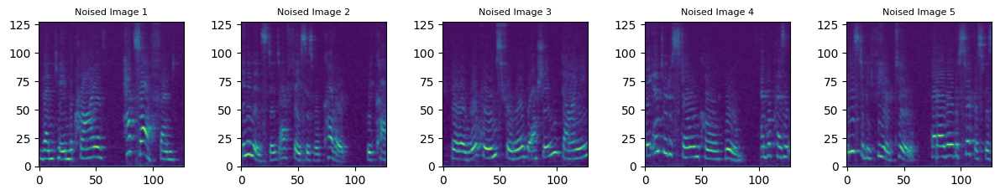

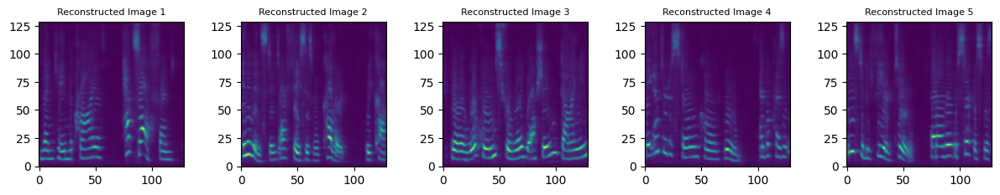

TRAIN - EPOCH 16/76 - loss: 0.0974
VALIDATION - EPOCH 16/76 - loss: 0.2060

--------------------------------------------------------------------------------
EPOCH 17/76
TRAIN - EPOCH 17/76 - loss: 0.0969
VALIDATION - EPOCH 17/76 - loss: 0.2034

--------------------------------------------------------------------------------
EPOCH 18/76
TRAIN - EPOCH 18/76 - loss: 0.0966
VALIDATION - EPOCH 18/76 - loss: 0.2071

--------------------------------------------------------------------------------
EPOCH 19/76
TRAIN - EPOCH 19/76 - loss: 0.0964
VALIDATION - EPOCH 19/76 - loss: 0.2068

--------------------------------------------------------------------------------
EPOCH 20/76
TRAIN - EPOCH 20/76 - loss: 0.0958
VALIDATION - EPOCH 20/76 - loss: 0.2033

--------------------------------------------------------------------------------
EPOCH 21/76
TRAIN - EPOCH 21/76 - loss: 0.0958
VALIDATION - EPOCH 21/76 - loss: 0.2086

-------------------------------------------------------------------------------

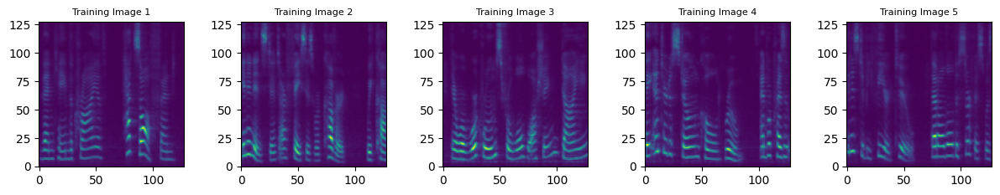

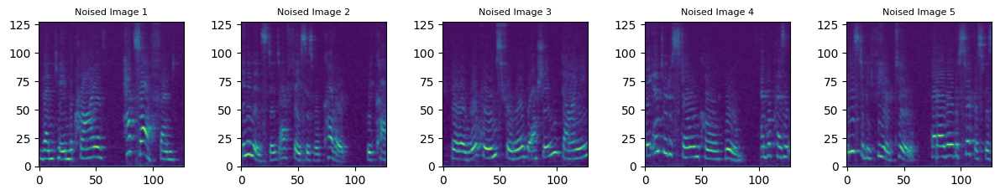

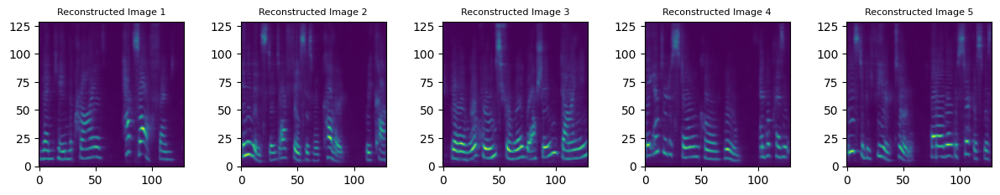

TRAIN - EPOCH 31/76 - loss: 0.0935
VALIDATION - EPOCH 31/76 - loss: 0.2023

--------------------------------------------------------------------------------
EPOCH 32/76
TRAIN - EPOCH 32/76 - loss: 0.0935
VALIDATION - EPOCH 32/76 - loss: 0.2043

--------------------------------------------------------------------------------
EPOCH 33/76
TRAIN - EPOCH 33/76 - loss: 0.0931
VALIDATION - EPOCH 33/76 - loss: 0.2024

--------------------------------------------------------------------------------
EPOCH 34/76
TRAIN - EPOCH 34/76 - loss: 0.0931
VALIDATION - EPOCH 34/76 - loss: 0.2025

--------------------------------------------------------------------------------
EPOCH 35/76
TRAIN - EPOCH 35/76 - loss: 0.0930
VALIDATION - EPOCH 35/76 - loss: 0.2040

--------------------------------------------------------------------------------
EPOCH 36/76
TRAIN - EPOCH 36/76 - loss: 0.0927
VALIDATION - EPOCH 36/76 - loss: 0.2010

-------------------------------------------------------------------------------

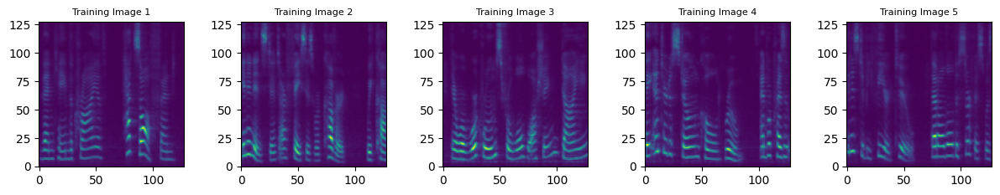

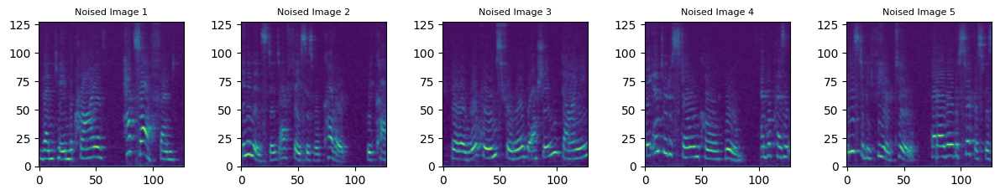

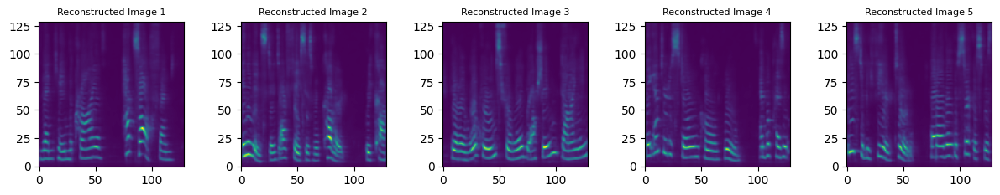

TRAIN - EPOCH 46/76 - loss: 0.0916
VALIDATION - EPOCH 46/76 - loss: 0.1992

--------------------------------------------------------------------------------
EPOCH 47/76
TRAIN - EPOCH 47/76 - loss: 0.0917
VALIDATION - EPOCH 47/76 - loss: 0.2006

--------------------------------------------------------------------------------
EPOCH 48/76
TRAIN - EPOCH 48/76 - loss: 0.0914
VALIDATION - EPOCH 48/76 - loss: 0.1989

--------------------------------------------------------------------------------
EPOCH 49/76
TRAIN - EPOCH 49/76 - loss: 0.0914
VALIDATION - EPOCH 49/76 - loss: 0.1986

--------------------------------------------------------------------------------
EPOCH 50/76
TRAIN - EPOCH 50/76 - loss: 0.0914
VALIDATION - EPOCH 50/76 - loss: 0.2008

--------------------------------------------------------------------------------
EPOCH 51/76
TRAIN - EPOCH 51/76 - loss: 0.0912
VALIDATION - EPOCH 51/76 - loss: 0.1978

-------------------------------------------------------------------------------

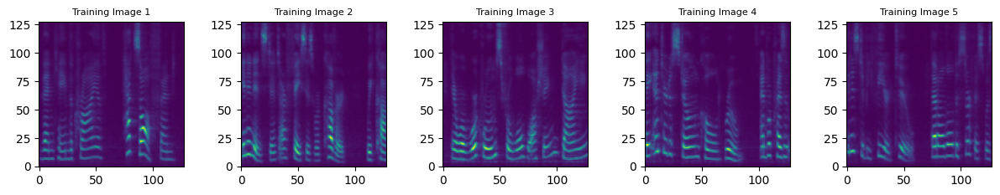

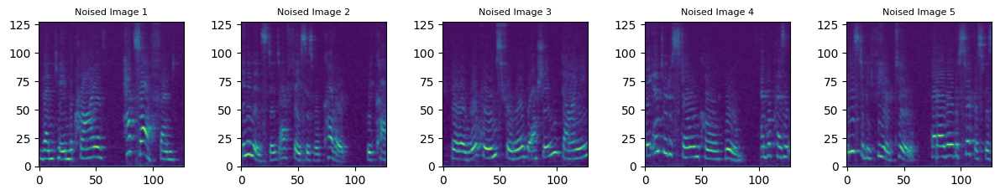

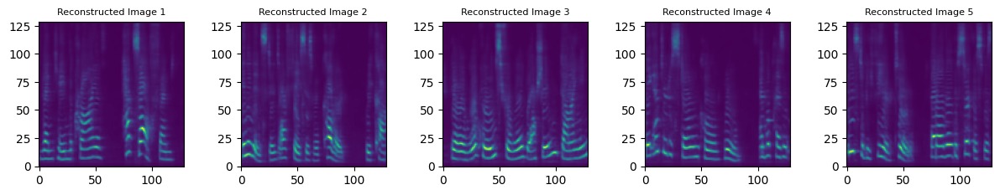

TRAIN - EPOCH 61/76 - loss: 0.0903
VALIDATION - EPOCH 61/76 - loss: 0.1975

--------------------------------------------------------------------------------
EPOCH 62/76
TRAIN - EPOCH 62/76 - loss: 0.0906
VALIDATION - EPOCH 62/76 - loss: 0.1971

--------------------------------------------------------------------------------
EPOCH 63/76
TRAIN - EPOCH 63/76 - loss: 0.0903
VALIDATION - EPOCH 63/76 - loss: 0.1966

--------------------------------------------------------------------------------
EPOCH 64/76
TRAIN - EPOCH 64/76 - loss: 0.0904
VALIDATION - EPOCH 64/76 - loss: 0.1956

--------------------------------------------------------------------------------
EPOCH 65/76
TRAIN - EPOCH 65/76 - loss: 0.0902
VALIDATION - EPOCH 65/76 - loss: 0.1948

--------------------------------------------------------------------------------
EPOCH 66/76
TRAIN - EPOCH 66/76 - loss: 0.0901
VALIDATION - EPOCH 66/76 - loss: 0.1953

-------------------------------------------------------------------------------

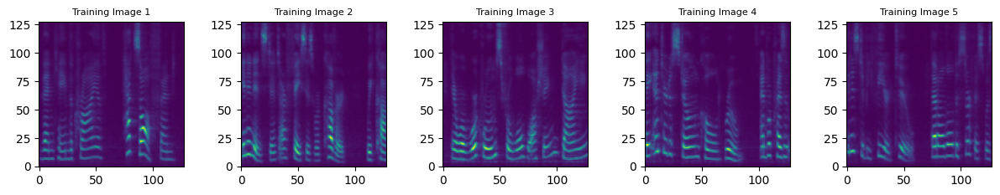

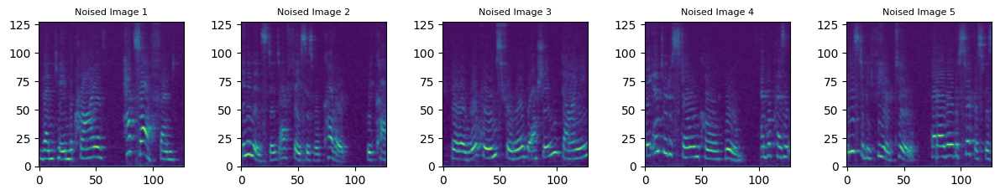

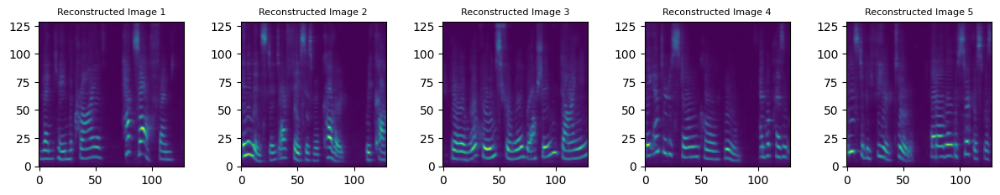

TRAIN - EPOCH 76/76 - loss: 0.0895
VALIDATION - EPOCH 76/76 - loss: 0.1951

--------------------------------------------------------------------------------


In [ ]:
### Initialize the two networks
encoder = Encoder()
decoder = Decoder()

### Define the loss function
loss_fn = torch.nn.L1Loss()

### Define an optimizer (both for the encoder and the decoder!)
lr = 5e-4 # Learning rate
params_to_optimize = [
    {'params': encoder.parameters()},
    {'params': decoder.parameters(), "lr": 0.001}
]
weight_decay = 1e-5
optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=weight_decay)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
encoder.to(device)
decoder.to(device)


T1, V1 = [], []
### Training cycle
num_epochs = 76
for epoch in range(num_epochs):
    print('EPOCH %d/%d' % (epoch + 1, num_epochs))

    ### Training (use the training function)
    train_loss = train_epoch(
        encoder=encoder,
        decoder=decoder,
        device=device,
        dataloader=dataloader,
        dataloader_noised=dataloader_noised,
        loss_fn=loss_fn,
        optimizer=optim,
        k=epoch,
        weight_decay=weight_decay,
        visualize=True)
    print(f'TRAIN - EPOCH {epoch+1}/{num_epochs} - loss: {train_loss:.4f}')
    T1.append(train_loss)

    ### Validation  (use the testing function)
    val_loss = test_epoch(
        encoder=encoder,
        decoder=decoder,
        device=device,
        dataloader=test_dataloader,
        dataloader_noised=test_dataloader_noised,
        loss_fn=loss_fn,
        weight_decay=weight_decay)
    # Print Validationloss
    print(f'VALIDATION - EPOCH {epoch+1}/{num_epochs} - loss: {val_loss:.4f}\n')
    V1.append(val_loss)

    print('--------------------------------------------------------------------------------')

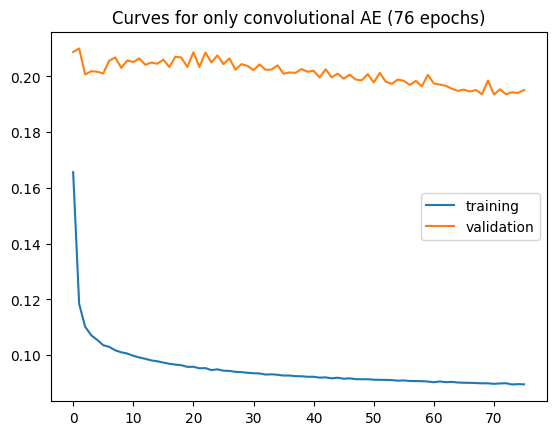

In [ ]:
plt.plot(T1, label='training')
V1_item = [x.item() for x in V1]
plt.plot(V1_item, label='validation')
plt.legend()
plt.title(f'Curves for only convolutional AE ({num_epochs} epochs)');

Observing the reconstructed spectrograms during training, we notice how this configuration is immediately proficient at correctly processing distorted spectra, achieving a high level of cleanliness. However, upon analyzing the validation curve, it becomes evident that the performance on this set is not favorable, and there is no indication of a gradual improvement. This is a clear sign of overfitting, suggesting that the model has essentially memorized the data and learned to restore it, but is unable to adapt this processing to external data outside the training set.

The reasons behind this overfitting can be manifold, primarily stemming from the limited dataset size, which, unfortunately, could not be expanded due to hardware constraints. One approach to mitigate overfitting could involve: reducing the model's complexity, exploring different types of regularization, or utilizing alternative loss functions.

Lets try this model over a training and a test data:

>Training Data

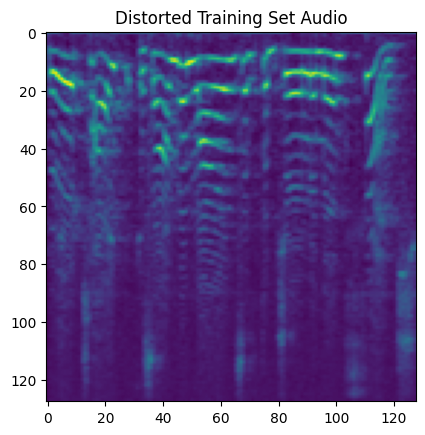

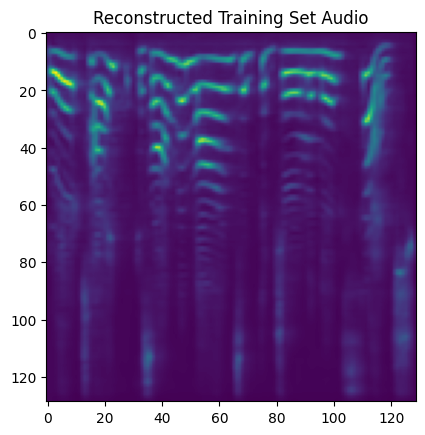

In [ ]:
test_tensor = custom_dataset_noised[0].unsqueeze(0).to(device)
test_encoded = encoder(test_tensor)
test_decoded = decoder(test_encoded)
# test_decoded.shape
numpy_decoded = test_decoded.squeeze().cpu().detach().numpy()
numpy_mel = numpy_decoded ** (4)
y_decoded = librosa.feature.inverse.mel_to_audio(numpy_mel)
yo = librosa.feature.inverse.mel_to_audio((test_tensor**4).squeeze().cpu().detach().numpy())
# display
plt.figure()
plt.title(f'Distorted Training Set Audio')
plt.imshow(test_tensor.squeeze().cpu().detach().numpy())
plt.show()
display(Audio(yo, rate=22050))
plt.figure()
plt.title(f'Reconstructed Training Set Audio')
plt.imshow(numpy_decoded)
plt.show()
display(Audio(y_decoded, rate=22050))

> Test Data

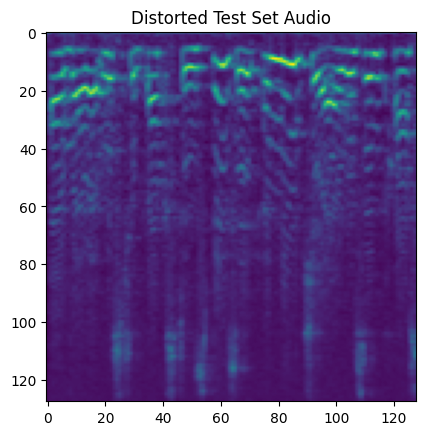

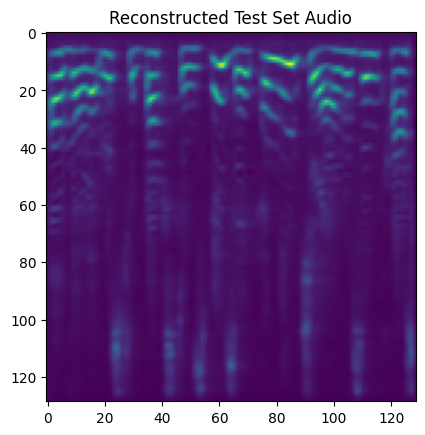

In [ ]:
test_tensor = test_dataset_noised[0].unsqueeze(0).to(device)
test_encoded = encoder(test_tensor)
test_decoded = decoder(test_encoded)
# test_decoded.shape
numpy_decoded = test_decoded.squeeze().cpu().detach().numpy()
numpy_mel = numpy_decoded ** (4)
y_decoded = librosa.feature.inverse.mel_to_audio(numpy_mel)
yo = librosa.feature.inverse.mel_to_audio((test_tensor**4).squeeze().cpu().detach().numpy())
# display
plt.figure()
plt.title(f'Distorted Test Set Audio')
plt.imshow(test_tensor.squeeze().cpu().detach().numpy())
plt.show()
display(Audio(yo, rate=22050))
plt.figure()
plt.title(f'Reconstructed Test Set Audio')
plt.imshow(numpy_decoded)
plt.show()
display(Audio(y_decoded, rate=22050))

We observe that in the case of reconstruction on an example outside the training set, the model still performs adequately well for the human ear, despite the computed error being noticeably higher compared to the reconstruction with a spectrogram from the training set

This suggests that, in this particular case (limited dataset and common distortion within the dataset), an autoencoder with only convolutional layers outperforms one with a fully connected layer in the middle. The question we now pose is: is there a way to enhance the algorithm? Can we mitigate the overfitting phenomenon just observed?

-------------------------------------------------------------------------------------------
Comparing different Loss Functions: *Mean Squared Error*, *Mean Absolute Error*, *SSIM*

**About Structural Similarity Index Metric (SSIM)**

The SSIM metric is a widely used indicator for evaluating the quality of images. It provides a measure of how similar two images are in structure. A high SSIM indicates greater similarity between the images.

The SSIM metric is based on three main components:
- **Luminance (L)**: Measures the average luminance difference between the two images.
- **Contrast (C)**: Measures how different the contrast of the sample image is from the reference image.
- **Structure (S)**: Evaluates the similarity of the detail structures between the two images.

The total SSIM is the product of these three components: $SSIM = L^α ⋅C^\beta \cdot S^\gamma$, where for semplicity usually is computated with $\alpha = \beta = \gamma = 1$.

## Formulas
The specific formulas to calculate the SSIM components are as follows:

- **Luminance (L)**:
 $$L(x, y) = \frac{{2 \cdot \mu_x \cdot \mu_y + C_1}}{{\mu_x^2 + \mu_y^2 + C_1}} $$

- **Contrast (C)**:
 $$C(x, y) = \frac{{2 \cdot \sigma_x \cdot \sigma_y + C_2}}{{\sigma_x^2 + \sigma_y^2 + C_2}} $$

- **Structure (S)**:
 $$S(x, y) = \frac{{\sigma_{xy} + C_3}}{{\sigma_x \cdot \sigma_y + C_3}} $$

Where:
- \( $\mu_x, \mu_y $\) are the means of the reference and sample images.
- \( $\sigma_x, \sigma_y $\) are the standard deviations of the reference and sample images.
- \( $\sigma_{xy} $\) is the covariance between the two images.
- \( $C_1, C_2, C_3 $\) are constants to stabilize the calculation.

The SSIM value returns a value between -1 and 1, where 1 indicates perfect structural similarity between the images. A value closer to 1 indicates better quality. In order to minimize the error, we employ the following formulation:
$$ error = 1 - SSIM $$



In [ ]:
from torchmetrics.image import StructuralSimilarityIndexMeasure

### Training function
def train_epoch_2(encoder, decoder, device, dataloader, dataloader_noised, optimizer, k, weight_decay, err='MSE', visualize=False):
    # Set train mode for both the encoder and the decoder
    encoder.train()
    decoder.train()
    losses = []
    ssim = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for j, (image_batch, image_batch_noised) in enumerate(zip(dataloader, dataloader_noised)):
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        image_batch_noised = image_batch_noised.to(device)
        # Decode data
        encoded_data = encoder(image_batch_noised)
        decoded_data = decoder(encoded_data)
        decoded_data = decoded_data[:,:,:-1,:-1]

        # Calculate the reconstruction loss
        if err == 'SSIM':
            reconstruction_loss = 1 - ssim(decoded_data, image_batch)
        else:
            if err == 'MSE':
                loss_fn = torch.nn.MSELoss().to(device)
            elif err == 'MAE':
                loss_fn = torch.nn.L1Loss()
            reconstruction_loss = loss_fn(decoded_data, image_batch)



        # Calculate the regularization term (L2 norm of the parameters)
        l2_regularization = 0.0
        for param in encoder.parameters():
            l2_regularization += torch.norm(param)**2
        for param in decoder.parameters():
            l2_regularization += torch.norm(param)**2
        l2_regularization *= 0.5 * weight_decay

        # Add the regularization term to the loss
        loss = reconstruction_loss + l2_regularization
        #-----------------------------

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        losses.append(loss.detach().cpu().numpy())
        # print(f'------ Loss: {loss:.4f}')
    losses = np.mean(losses)

    if visualize:
        if k % 20 == 0:
            print_recons(image_batch, image_batch_noised, decoded_data)

    return losses

def test_epoch_2(encoder, decoder, device, dataloader, dataloader_noised, weight_decay, err='MSE'):
    encoder.eval()
    decoder.eval()

    ssim = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)

    with torch.no_grad():
        conc_out = []
        conc_label = []
        l2_regularization = 0.0

        for image_batch, image_batch_noised in zip(dataloader, dataloader_noised):
            image_batch = image_batch.to(device)
            image_batch_noised = image_batch_noised.to(device)

            encoded_data = encoder(image_batch_noised)
            decoded_data = decoder(encoded_data)
            decoded_data = decoded_data[:,:,:-1,:-1]

            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())

            # Calculate the L2 regularization term
            for param in encoder.parameters():
                l2_regularization += torch.norm(param)**2
            for param in decoder.parameters():
                l2_regularization += torch.norm(param)**2

        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)

        # Calculate the reconstruction loss
        if err == 'SSIM':
            reconstruction_loss = 1 - ssim(decoded_data, image_batch)
        else:
            if err == 'MSE':
                loss_fn = torch.nn.MSELoss().to(device)
            elif err == 'MAE':
                loss_fn = torch.nn.L1Loss()
            reconstruction_loss = loss_fn(decoded_data, image_batch)

        # Calculate the total loss with L2 regularization
        l2_regularization *= 0.5 * weight_decay
        val_loss = reconstruction_loss + l2_regularization

    return val_loss.data

---- loss type: MSE ----
Selected device: cuda
EPOCH 1/61


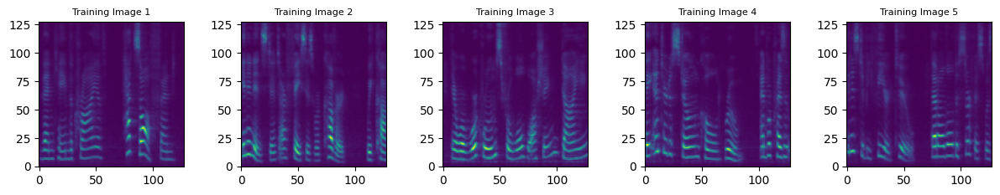

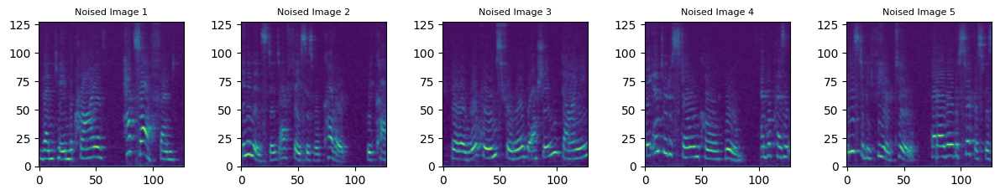

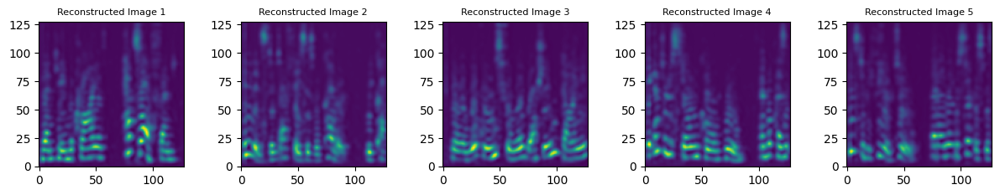

TRAIN - EPOCH 1/61 - loss: 0.0934
VALIDATION - EPOCH 1/61 - loss: 0.1019

--------------------------------------------------------------------------------
EPOCH 2/61
TRAIN - EPOCH 2/61 - loss: 0.0441
VALIDATION - EPOCH 2/61 - loss: 0.0930

--------------------------------------------------------------------------------
EPOCH 3/61
TRAIN - EPOCH 3/61 - loss: 0.0345
VALIDATION - EPOCH 3/61 - loss: 0.0945

--------------------------------------------------------------------------------
EPOCH 4/61
TRAIN - EPOCH 4/61 - loss: 0.0312
VALIDATION - EPOCH 4/61 - loss: 0.0926

--------------------------------------------------------------------------------
EPOCH 5/61
TRAIN - EPOCH 5/61 - loss: 0.0298
VALIDATION - EPOCH 5/61 - loss: 0.0882

--------------------------------------------------------------------------------
EPOCH 6/61
TRAIN - EPOCH 6/61 - loss: 0.0289
VALIDATION - EPOCH 6/61 - loss: 0.0882

--------------------------------------------------------------------------------
EPOCH 7/61
TRAI

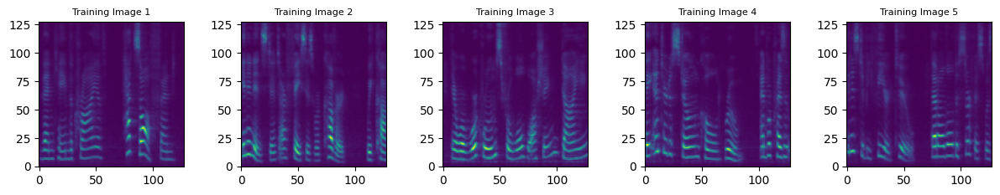

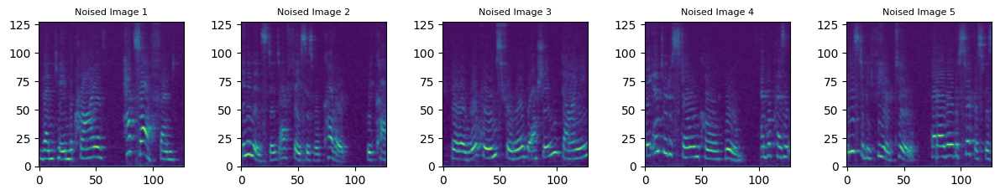

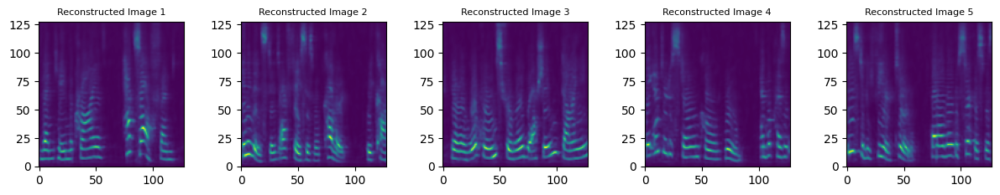

TRAIN - EPOCH 21/61 - loss: 0.0248
VALIDATION - EPOCH 21/61 - loss: 0.0889

--------------------------------------------------------------------------------
EPOCH 22/61
TRAIN - EPOCH 22/61 - loss: 0.0247
VALIDATION - EPOCH 22/61 - loss: 0.0890

--------------------------------------------------------------------------------
EPOCH 23/61
TRAIN - EPOCH 23/61 - loss: 0.0245
VALIDATION - EPOCH 23/61 - loss: 0.0890

--------------------------------------------------------------------------------
EPOCH 24/61
TRAIN - EPOCH 24/61 - loss: 0.0244
VALIDATION - EPOCH 24/61 - loss: 0.0894

--------------------------------------------------------------------------------
EPOCH 25/61
TRAIN - EPOCH 25/61 - loss: 0.0243
VALIDATION - EPOCH 25/61 - loss: 0.0880

--------------------------------------------------------------------------------
EPOCH 26/61
TRAIN - EPOCH 26/61 - loss: 0.0241
VALIDATION - EPOCH 26/61 - loss: 0.0888

-------------------------------------------------------------------------------

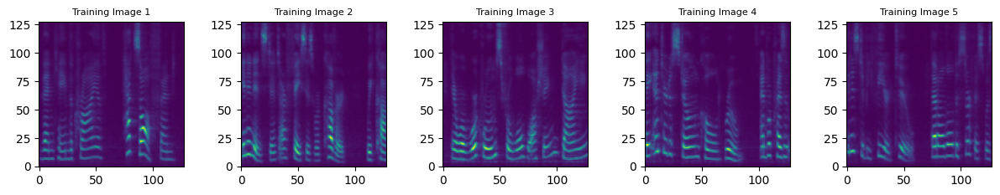

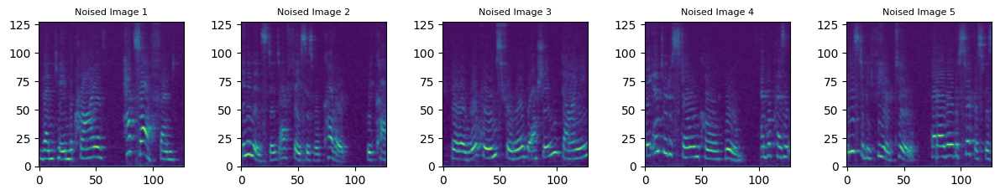

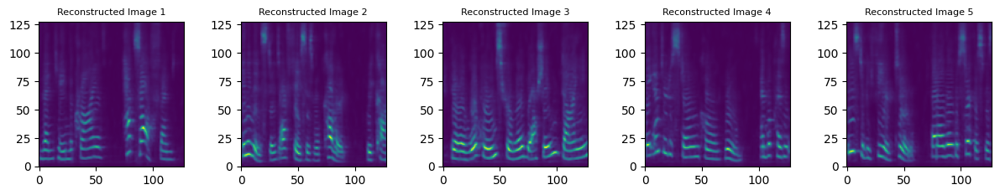

TRAIN - EPOCH 41/61 - loss: 0.0228
VALIDATION - EPOCH 41/61 - loss: 0.0868

--------------------------------------------------------------------------------
EPOCH 42/61
TRAIN - EPOCH 42/61 - loss: 0.0228
VALIDATION - EPOCH 42/61 - loss: 0.0861

--------------------------------------------------------------------------------
EPOCH 43/61
TRAIN - EPOCH 43/61 - loss: 0.0228
VALIDATION - EPOCH 43/61 - loss: 0.0849

--------------------------------------------------------------------------------
EPOCH 44/61
TRAIN - EPOCH 44/61 - loss: 0.0227
VALIDATION - EPOCH 44/61 - loss: 0.0855

--------------------------------------------------------------------------------
EPOCH 45/61
TRAIN - EPOCH 45/61 - loss: 0.0227
VALIDATION - EPOCH 45/61 - loss: 0.0856

--------------------------------------------------------------------------------
EPOCH 46/61
TRAIN - EPOCH 46/61 - loss: 0.0226
VALIDATION - EPOCH 46/61 - loss: 0.0850

-------------------------------------------------------------------------------

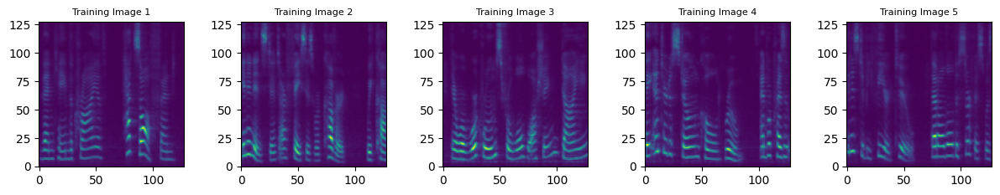

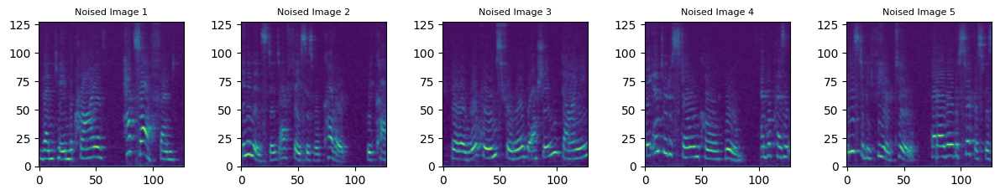

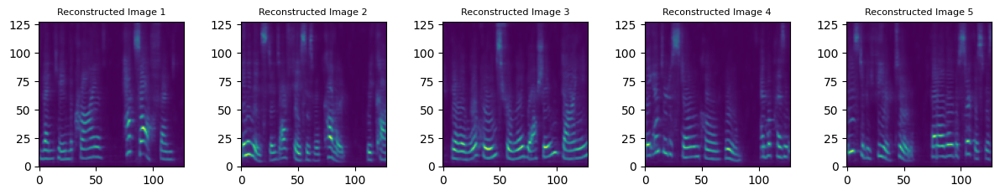

TRAIN - EPOCH 61/61 - loss: 0.0218
VALIDATION - EPOCH 61/61 - loss: 0.0852

--------------------------------------------------------------------------------
---- loss type: MAE ----
Selected device: cuda
EPOCH 1/61


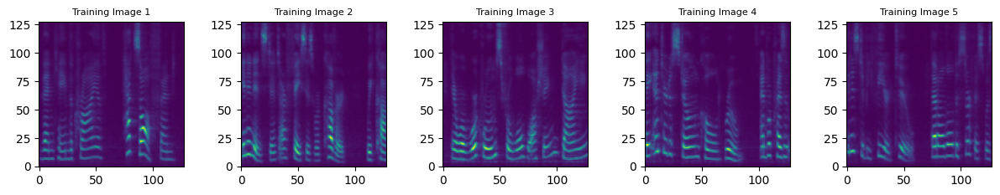

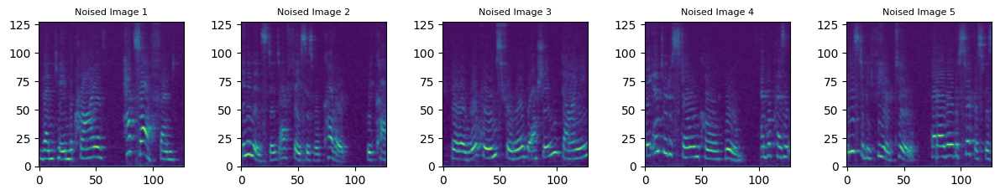

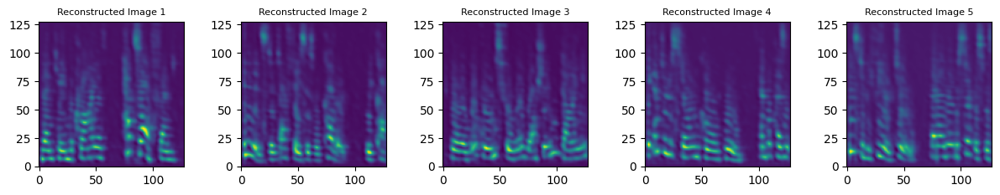

TRAIN - EPOCH 1/61 - loss: 0.1696
VALIDATION - EPOCH 1/61 - loss: 0.1802

--------------------------------------------------------------------------------
EPOCH 2/61
TRAIN - EPOCH 2/61 - loss: 0.1204
VALIDATION - EPOCH 2/61 - loss: 0.1748

--------------------------------------------------------------------------------
EPOCH 3/61
TRAIN - EPOCH 3/61 - loss: 0.1098
VALIDATION - EPOCH 3/61 - loss: 0.1813

--------------------------------------------------------------------------------
EPOCH 4/61
TRAIN - EPOCH 4/61 - loss: 0.1061
VALIDATION - EPOCH 4/61 - loss: 0.1758

--------------------------------------------------------------------------------
EPOCH 5/61
TRAIN - EPOCH 5/61 - loss: 0.1046
VALIDATION - EPOCH 5/61 - loss: 0.1811

--------------------------------------------------------------------------------
EPOCH 6/61
TRAIN - EPOCH 6/61 - loss: 0.1029
VALIDATION - EPOCH 6/61 - loss: 0.1786

--------------------------------------------------------------------------------
EPOCH 7/61
TRAI

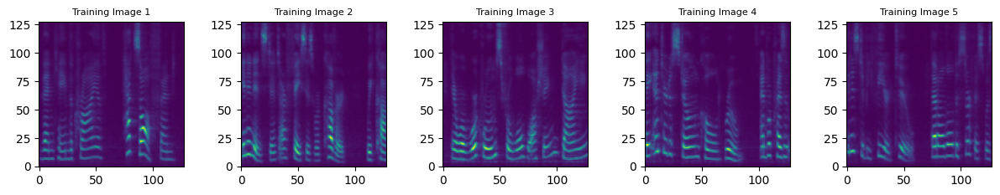

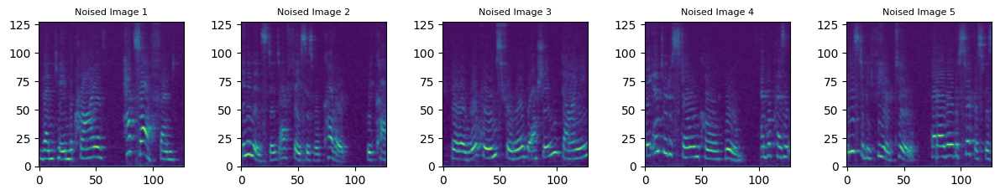

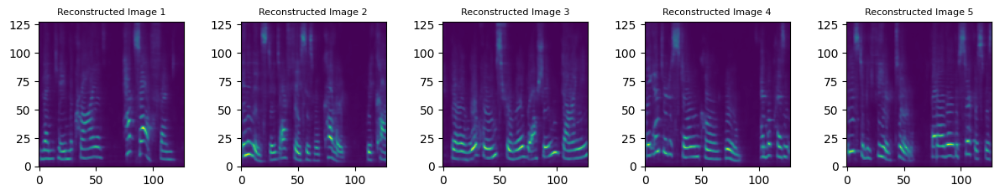

TRAIN - EPOCH 21/61 - loss: 0.0955
VALIDATION - EPOCH 21/61 - loss: 0.1779

--------------------------------------------------------------------------------
EPOCH 22/61
TRAIN - EPOCH 22/61 - loss: 0.0952
VALIDATION - EPOCH 22/61 - loss: 0.1751

--------------------------------------------------------------------------------
EPOCH 23/61
TRAIN - EPOCH 23/61 - loss: 0.0951
VALIDATION - EPOCH 23/61 - loss: 0.1776

--------------------------------------------------------------------------------
EPOCH 24/61
TRAIN - EPOCH 24/61 - loss: 0.0949
VALIDATION - EPOCH 24/61 - loss: 0.1775

--------------------------------------------------------------------------------
EPOCH 25/61
TRAIN - EPOCH 25/61 - loss: 0.0946
VALIDATION - EPOCH 25/61 - loss: 0.1746

--------------------------------------------------------------------------------
EPOCH 26/61
TRAIN - EPOCH 26/61 - loss: 0.0946
VALIDATION - EPOCH 26/61 - loss: 0.1744

-------------------------------------------------------------------------------

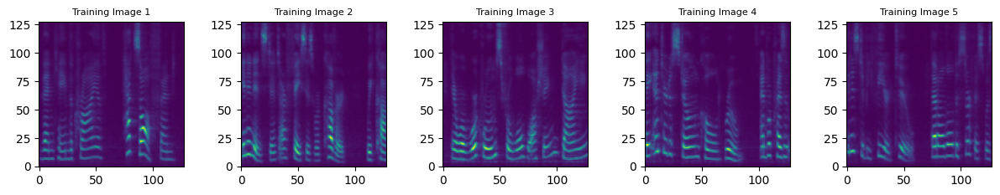

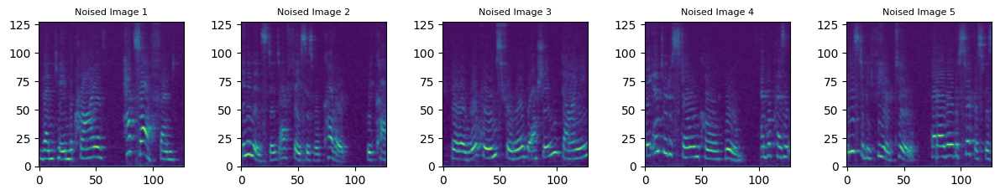

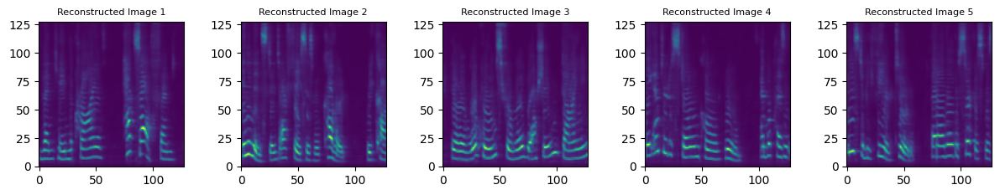

TRAIN - EPOCH 41/61 - loss: 0.0925
VALIDATION - EPOCH 41/61 - loss: 0.1704

--------------------------------------------------------------------------------
EPOCH 42/61
TRAIN - EPOCH 42/61 - loss: 0.0924
VALIDATION - EPOCH 42/61 - loss: 0.1701

--------------------------------------------------------------------------------
EPOCH 43/61
TRAIN - EPOCH 43/61 - loss: 0.0923
VALIDATION - EPOCH 43/61 - loss: 0.1698

--------------------------------------------------------------------------------
EPOCH 44/61
TRAIN - EPOCH 44/61 - loss: 0.0923
VALIDATION - EPOCH 44/61 - loss: 0.1694

--------------------------------------------------------------------------------
EPOCH 45/61
TRAIN - EPOCH 45/61 - loss: 0.0921
VALIDATION - EPOCH 45/61 - loss: 0.1699

--------------------------------------------------------------------------------
EPOCH 46/61
TRAIN - EPOCH 46/61 - loss: 0.0921
VALIDATION - EPOCH 46/61 - loss: 0.1690

-------------------------------------------------------------------------------

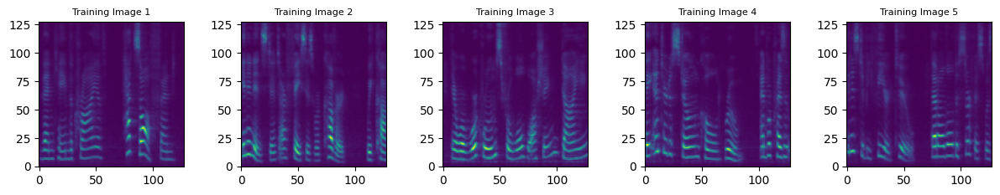

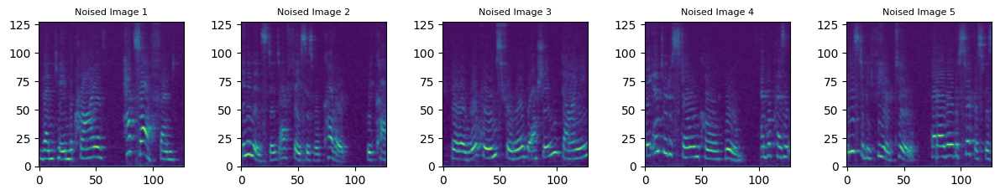

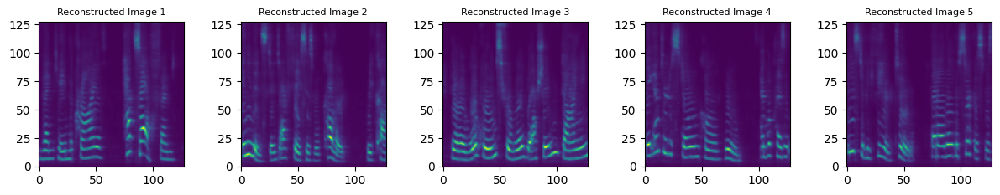

TRAIN - EPOCH 61/61 - loss: 0.0909
VALIDATION - EPOCH 61/61 - loss: 0.1644

--------------------------------------------------------------------------------
---- loss type: SSIM ----
Selected device: cuda
EPOCH 1/61


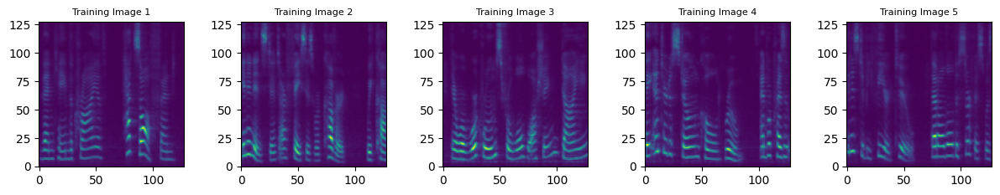

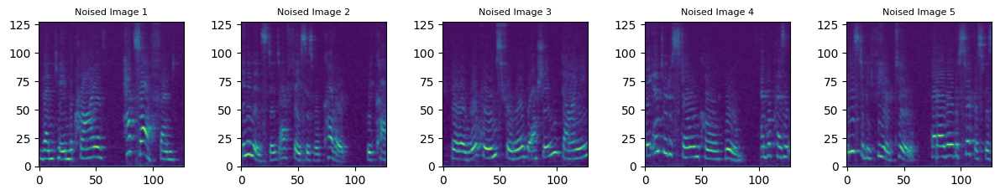

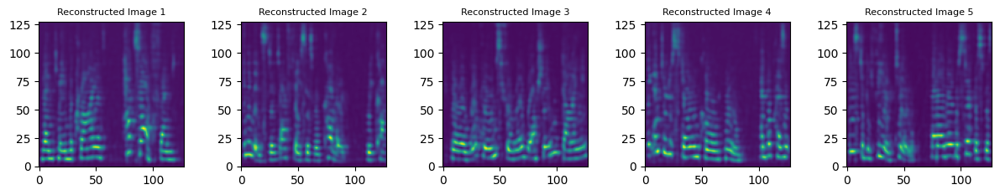

TRAIN - EPOCH 1/61 - loss: 0.5226
VALIDATION - EPOCH 1/61 - loss: 0.5102

--------------------------------------------------------------------------------
EPOCH 2/61
TRAIN - EPOCH 2/61 - loss: 0.3564
VALIDATION - EPOCH 2/61 - loss: 0.4829

--------------------------------------------------------------------------------
EPOCH 3/61
TRAIN - EPOCH 3/61 - loss: 0.3318
VALIDATION - EPOCH 3/61 - loss: 0.4806

--------------------------------------------------------------------------------
EPOCH 4/61
TRAIN - EPOCH 4/61 - loss: 0.3211
VALIDATION - EPOCH 4/61 - loss: 0.4983

--------------------------------------------------------------------------------
EPOCH 5/61
TRAIN - EPOCH 5/61 - loss: 0.3140
VALIDATION - EPOCH 5/61 - loss: 0.4819

--------------------------------------------------------------------------------
EPOCH 6/61
TRAIN - EPOCH 6/61 - loss: 0.3101
VALIDATION - EPOCH 6/61 - loss: 0.4660

--------------------------------------------------------------------------------
EPOCH 7/61
TRAI

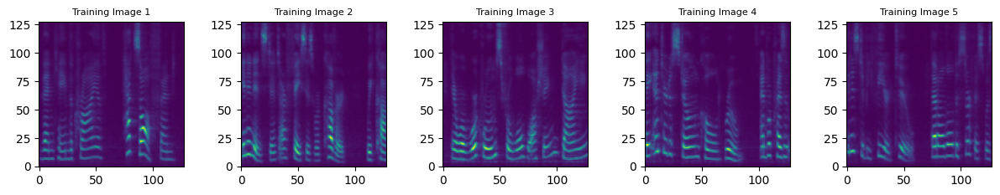

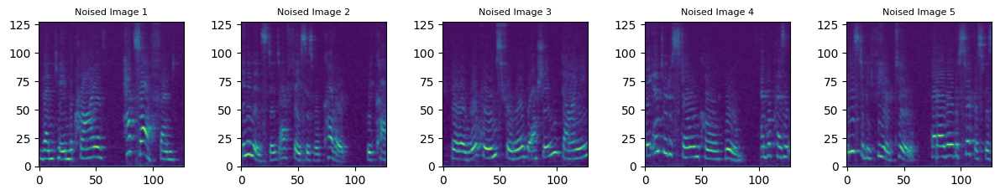

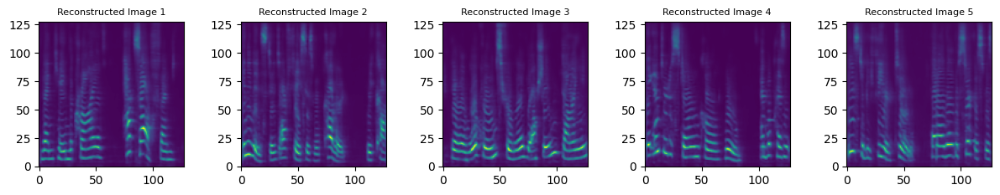

TRAIN - EPOCH 21/61 - loss: 0.2888
VALIDATION - EPOCH 21/61 - loss: 0.4507

--------------------------------------------------------------------------------
EPOCH 22/61
TRAIN - EPOCH 22/61 - loss: 0.2870
VALIDATION - EPOCH 22/61 - loss: 0.4324

--------------------------------------------------------------------------------
EPOCH 23/61
TRAIN - EPOCH 23/61 - loss: 0.2869
VALIDATION - EPOCH 23/61 - loss: 0.4270

--------------------------------------------------------------------------------
EPOCH 24/61
TRAIN - EPOCH 24/61 - loss: 0.2862
VALIDATION - EPOCH 24/61 - loss: 0.4337

--------------------------------------------------------------------------------
EPOCH 25/61
TRAIN - EPOCH 25/61 - loss: 0.2858
VALIDATION - EPOCH 25/61 - loss: 0.4137

--------------------------------------------------------------------------------
EPOCH 26/61
TRAIN - EPOCH 26/61 - loss: 0.2863
VALIDATION - EPOCH 26/61 - loss: 0.4667

-------------------------------------------------------------------------------

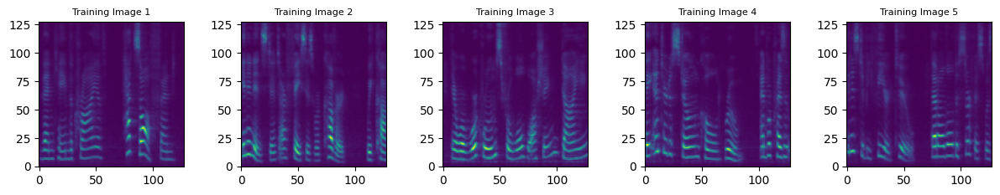

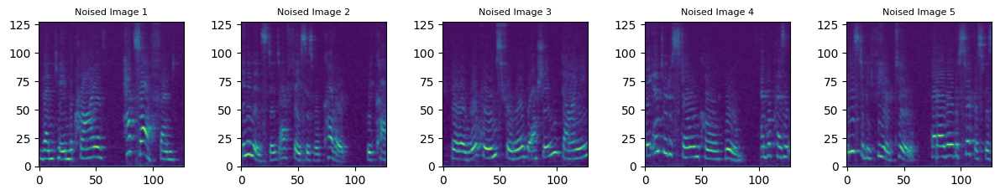

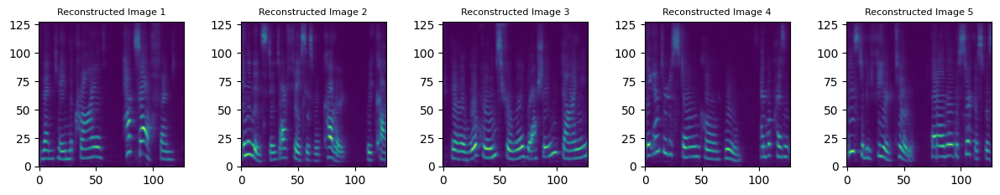

TRAIN - EPOCH 41/61 - loss: 0.2785
VALIDATION - EPOCH 41/61 - loss: 0.4077

--------------------------------------------------------------------------------
EPOCH 42/61
TRAIN - EPOCH 42/61 - loss: 0.2783
VALIDATION - EPOCH 42/61 - loss: 0.4078

--------------------------------------------------------------------------------
EPOCH 43/61
TRAIN - EPOCH 43/61 - loss: 0.2777
VALIDATION - EPOCH 43/61 - loss: 0.4073

--------------------------------------------------------------------------------
EPOCH 44/61
TRAIN - EPOCH 44/61 - loss: 0.2775
VALIDATION - EPOCH 44/61 - loss: 0.4001

--------------------------------------------------------------------------------
EPOCH 45/61
TRAIN - EPOCH 45/61 - loss: 0.2775
VALIDATION - EPOCH 45/61 - loss: 0.4042

--------------------------------------------------------------------------------
EPOCH 46/61
TRAIN - EPOCH 46/61 - loss: 0.2770
VALIDATION - EPOCH 46/61 - loss: 0.4028

-------------------------------------------------------------------------------

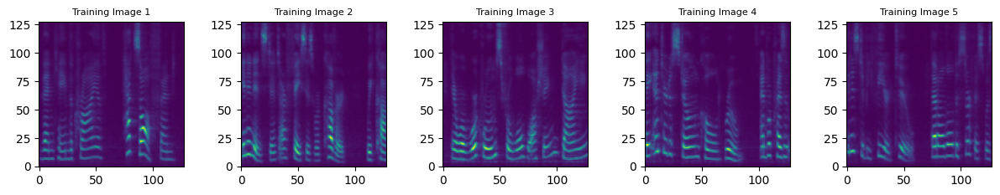

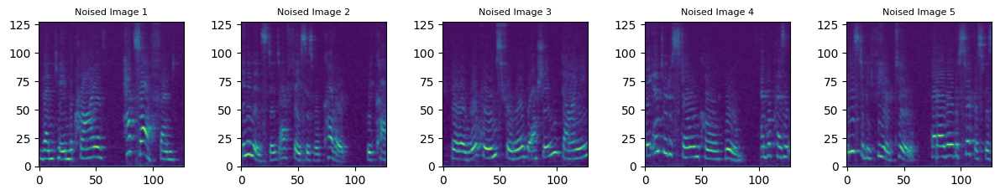

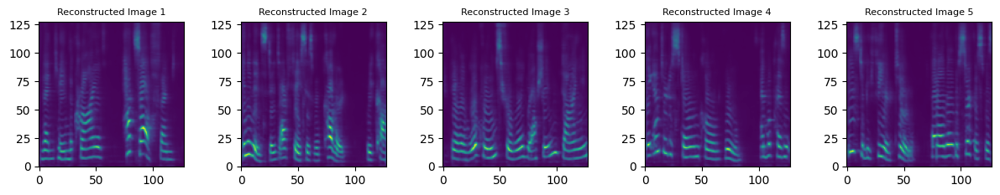

TRAIN - EPOCH 61/61 - loss: 0.2734
VALIDATION - EPOCH 61/61 - loss: 0.3979

--------------------------------------------------------------------------------


In [ ]:
err_types = ['MSE', 'MAE', 'SSIM']
num_epochs = 61
training_curves_2, validation_curves_2 = np.zeros((3,num_epochs)), np.zeros((3,num_epochs))


for i, err in enumerate(err_types):
    print(f'---- loss type: {err} ----')
    ### Initialize the two networks
    encoder = Encoder()
    decoder = Decoder()

    ### Define the loss function
    loss_fn = torch.nn.L1Loss()

    ### Define an optimizer (both for the encoder and the decoder!)
    lr = 5e-4 # Learning rate
    params_to_optimize = [
        {'params': encoder.parameters()},
        {'params': decoder.parameters(), "lr": 0.001}
    ]
    weight_decay = 1e-5
    optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=weight_decay)

    # Check if the GPU is available
    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    print(f'Selected device: {device}')

    # Move both the encoder and the decoder to the selected device
    encoder.to(device)
    decoder.to(device)


    T, V = [], []
    ### Training cycle
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))

        ### Training (use the training function)
        train_loss = train_epoch_2(
            encoder=encoder,
            decoder=decoder,
            device=device,
            dataloader=dataloader,
            dataloader_noised=dataloader_noised,
            optimizer=optim,
            k=epoch,
            weight_decay=weight_decay,
            err=err,
            visualize=True)
        print(f'TRAIN - EPOCH {epoch+1}/{num_epochs} - loss: {train_loss:.4f}')
        training_curves_2[i, epoch] = train_loss

        ### Validation  (use the testing function)
        val_loss = test_epoch_2(
            encoder=encoder,
            decoder=decoder,
            device=device,
            dataloader=test_dataloader,
            dataloader_noised=test_dataloader_noised,
            weight_decay=weight_decay,
            err=err)
        # Print Validationloss
        print(f'VALIDATION - EPOCH {epoch+1}/{num_epochs} - loss: {val_loss:.4f}\n')
        validation_curves_2[i, epoch] = val_loss.item()

        print('--------------------------------------------------------------------------------')

In [ ]:
training_curves_2_copy = training_curves_2.copy()
validation_curves_2_copy = validation_curves_2.copy()

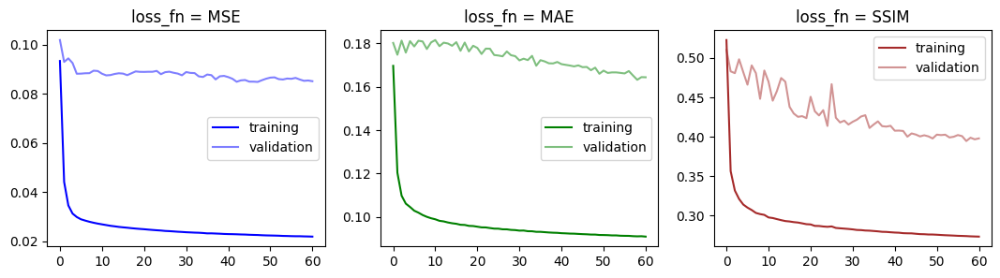

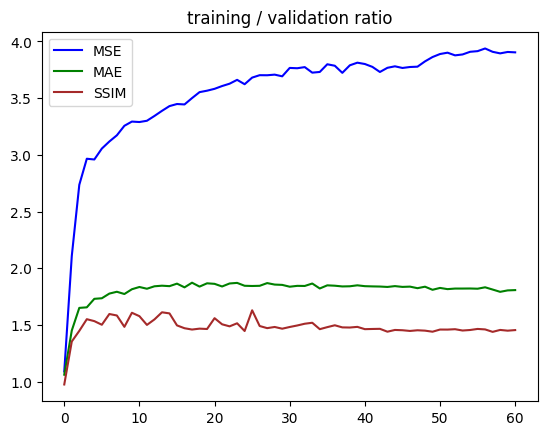

In [ ]:
ratios_curve_2 = []
colors = ['blue', 'green', 'brown']
fig, ax = plt.subplots(1, 3, figsize=(13, 3))
for i, err in enumerate(err_types):
    ratios_curve_2.append( validation_curves_2_copy[i] / training_curves_2_copy[i] )
    AX = ax[i]
    AX.set_title(f'loss_fn = {err}')
    AX.plot(training_curves_2_copy[i], c=colors[i], label=f'training')
    AX.plot(validation_curves_2_copy[i], c=colors[i], alpha=0.5, label=f'validation')
    AX.legend()
plt.show()

plt.figure()
for j, r in enumerate(ratios_curve_2):
    plt.title(f'training / validation ratio')
    plt.plot(r, c=colors[j], label=f'{err_types[j]}')
plt.legend();

Given that direct comparisons are not feasible as each metric is self-referential, these graphs depict how, for each type of loss function, the Training and Validation curves vary. We specifically focus on overfitting, indirectly suggested by the relationship between the training and validation curves. We observe that in the case of the Structural Similarity Index Metric (SSIM), the validation curve appears to exhibit a more pronounced decreasing trend compared to the other two. This indicates that the algorithm trained with SSIM ensures a good performance even with data external to the training set.

In [ ]:
# save arrays
np.save("/content/drive/MyDrive/NNDL/training_curves_2.npy", training_curves_2)
np.save("/content/drive/MyDrive/NNDL/validation_curves_2.npy", validation_curves_2)
np.save("/content/drive/MyDrive/NNDL/T1.npy", T1)
np.save("/content/drive/MyDrive/NNDL/V1_item.npy", V1_item)
print('file loaded!')

file loaded!


--------------------------------------------------------------------------------------------------------------------------------------------

## Different number of convolutional layers

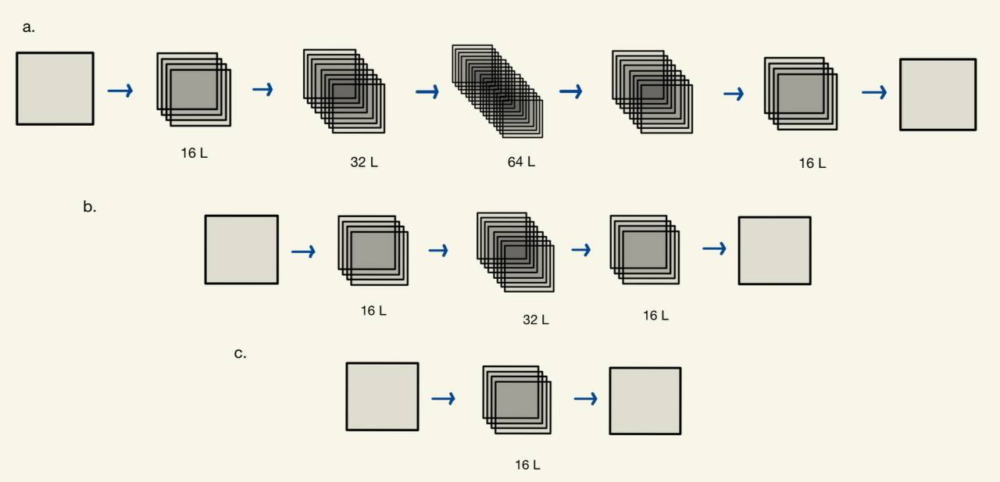

In [ ]:
# ENCODER - DECODER

class Encoder_A(nn.Module):

    def __init__(self):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = torch.nn.Sequential(
            torch.nn.Conv2d(1, 16, 3, stride=1, padding=1),
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),
            torch.nn.Conv2d(16, 32, 3, stride=1, padding=1),  # b, 8, 3, 3
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),  # b, 8, 2, 2
            torch.nn.Conv2d(32, 64, 3, stride=1, padding=1),  # b, 8, 3, 3
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1)
        )

    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        return x

class Decoder_A(nn.Module):

  def __init__(self):
      super().__init__()

      ### Convolutional section
      self.decoder_conv =nn.Sequential(
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(64, 32, 3, stride=1, padding=1),  # b, 16, 10, 10
          torch.nn.ReLU(True),
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(32, 16, 3, stride=1, padding=2),  # b, 16, 10, 10
          torch.nn.ReLU(True),
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(16, 1, 5, stride=1, padding=3)  # b, 8, 3, 3

          # torch.nn.Sigmoid()
      )

  def forward(self, x):
      # Apply transposed convolutions
      x = self.decoder_conv(x)
      return x
#----------------------------------------------------------------------------------------
# ENCODER - DECODER

class Encoder_B(nn.Module):

    def __init__(self):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = torch.nn.Sequential(
            torch.nn.Conv2d(1, 16, 3, stride=1, padding=1),
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),
            torch.nn.Conv2d(16, 32, 3, stride=1, padding=1),  # b, 8, 3, 3
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1)
        )

    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        return x

class Decoder_B(nn.Module):

  def __init__(self):
      super().__init__()

      ### Convolutional section
      self.decoder_conv =nn.Sequential(
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(32, 16, 3, stride=1, padding=2),  # b, 16, 10, 10
          torch.nn.ReLU(True),
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(16, 1, 5, stride=1, padding=3)
      )

  def forward(self, x):
      # Apply transposed convolutions
      x = self.decoder_conv(x)
      return x

#----------------------------------------------------------------------------------------
# ENCODER - DECODER

class Encoder_C(nn.Module):

    def __init__(self):
        super().__init__()

        ### Convolutional section
        self.encoder_cnn = torch.nn.Sequential(
            torch.nn.Conv2d(1, 16, 3, stride=1, padding=1),
            torch.nn.Dropout(0.2),
            torch.nn.ReLU(True),
            torch.nn.MaxPool2d(2, stride=1),
        )

    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        return x

class Decoder_C(nn.Module):

  def __init__(self):
      super().__init__()

      ### Convolutional section
      self.decoder_conv =nn.Sequential(
          torch.nn.Upsample(scale_factor=1, mode='nearest'),
          torch.nn.Conv2d(16, 1, 5, stride=1, padding=3)
      )

  def forward(self, x):
      # Apply transposed convolutions
      x = self.decoder_conv(x)
      return x

In [ ]:
### Training function
def train_epoch_3(encoder, decoder, device, dataloader, dataloader_noised, optimizer, k, weight_decay, err='MSE', visualize=False):
    # Set train mode for both the encoder and the decoder
    encoder.train()
    decoder.train()
    losses = []
    ssim = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for j, (image_batch, image_batch_noised) in enumerate(zip(dataloader, dataloader_noised)):
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        image_batch_noised = image_batch_noised.to(device)
        # Decode data
        encoded_data = encoder(image_batch_noised)
        decoded_data = decoder(encoded_data)
        decoded_data = decoded_data[:,:,:128,:128]

        # Calculate the reconstruction loss
        if err == 'SSIM':
            reconstruction_loss = 1 - ssim(decoded_data, image_batch)
        else:
            if err == 'MSE':
                loss_fn = torch.nn.MSELoss().to(device)
            elif err == 'MAE':
                loss_fn = torch.nn.L1Loss()
            reconstruction_loss = loss_fn(decoded_data, image_batch)



        # Calculate the regularization term (L2 norm of the parameters)
        l2_regularization = 0.0
        for param in encoder.parameters():
            l2_regularization += torch.norm(param)**2
        for param in decoder.parameters():
            l2_regularization += torch.norm(param)**2
        l2_regularization *= 0.5 * weight_decay

        # Add the regularization term to the loss
        loss = reconstruction_loss + l2_regularization
        #-----------------------------

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        losses.append(loss.detach().cpu().numpy())
        # print(f'------ Loss: {loss:.4f}')
    losses = np.mean(losses)

    if visualize:
        if k % 20 == 0:
            print_recons(image_batch, image_batch_noised, decoded_data)

    return losses

def test_epoch_3(encoder, decoder, device, dataloader, dataloader_noised, weight_decay, err='MSE'):
    encoder.eval()
    decoder.eval()

    ssim = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)

    with torch.no_grad():
        conc_out = []
        conc_label = []
        l2_regularization = 0.0

        for image_batch, image_batch_noised in zip(dataloader, dataloader_noised):
            image_batch = image_batch.to(device)
            image_batch_noised = image_batch_noised.to(device)

            encoded_data = encoder(image_batch_noised)
            decoded_data = decoder(encoded_data)
            decoded_data = decoded_data[:,:,:128,:128]

            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())

            # Calculate the L2 regularization term
            for param in encoder.parameters():
                l2_regularization += torch.norm(param)**2
            for param in decoder.parameters():
                l2_regularization += torch.norm(param)**2

        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)

        # Calculate the reconstruction loss
        if err == 'SSIM':
            reconstruction_loss = 1 - ssim(decoded_data, image_batch)
        else:
            if err == 'MSE':
                loss_fn = torch.nn.MSELoss().to(device)
            elif err == 'MAE':
                loss_fn = torch.nn.L1Loss()
            reconstruction_loss = loss_fn(decoded_data, image_batch)

        # Calculate the total loss with L2 regularization
        l2_regularization *= 0.5 * weight_decay
        val_loss = reconstruction_loss + l2_regularization

    return val_loss.data

In [ ]:
# prova con tutti
data = custom_dataset_noised[0].unsqueeze(0).to(device)
print(type(data))
encoderA, encoderB, encoderC = Encoder_A().to(device), Encoder_B().to(device), Encoder_C().to(device)
decoderA, decoderB, decoderC = Decoder_A().to(device), Decoder_B().to(device), Decoder_C().to(device)
# A
eA = encoderA(data)
dA = decoderA(eA)
print(dA.shape)
# B
eB = encoderB(data)
dB = decoderB(eB)
print(dB.shape)
# C
eC = encoderC(data)
dC = decoderC(eC)
print(dC.shape)

<class 'torch.Tensor'>
torch.Size([1, 1, 129, 129])
torch.Size([1, 1, 130, 130])
torch.Size([1, 1, 129, 129])


---- model type: A ----
Selected device: cuda
EPOCH 1/61


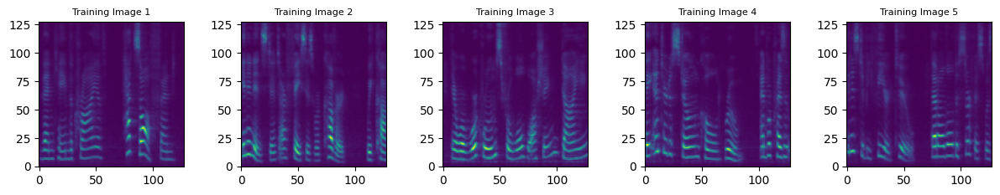

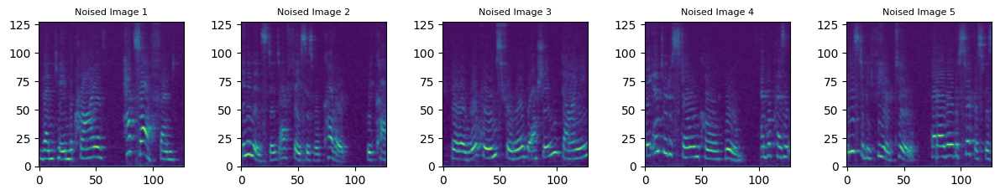

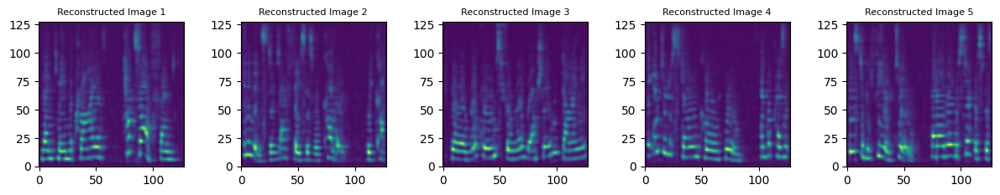

TRAIN - EPOCH 1/61 - loss: 0.5348
VALIDATION - EPOCH 1/61 - loss: 0.5535

--------------------------------------------------------------------------------
EPOCH 2/61
TRAIN - EPOCH 2/61 - loss: 0.3583
VALIDATION - EPOCH 2/61 - loss: 0.5525

--------------------------------------------------------------------------------
EPOCH 3/61
TRAIN - EPOCH 3/61 - loss: 0.3354
VALIDATION - EPOCH 3/61 - loss: 0.5744

--------------------------------------------------------------------------------
EPOCH 4/61
TRAIN - EPOCH 4/61 - loss: 0.3243
VALIDATION - EPOCH 4/61 - loss: 0.5752

--------------------------------------------------------------------------------
EPOCH 5/61
TRAIN - EPOCH 5/61 - loss: 0.3174
VALIDATION - EPOCH 5/61 - loss: 0.5638

--------------------------------------------------------------------------------
EPOCH 6/61
TRAIN - EPOCH 6/61 - loss: 0.3133
VALIDATION - EPOCH 6/61 - loss: 0.5842

--------------------------------------------------------------------------------
EPOCH 7/61
TRAI

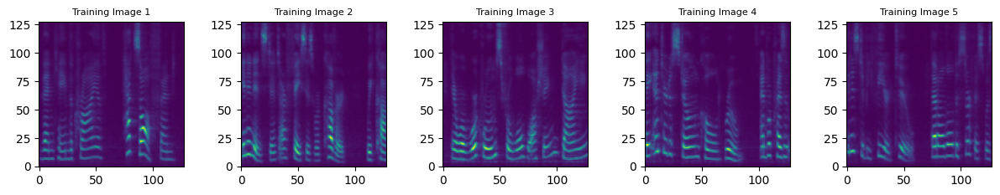

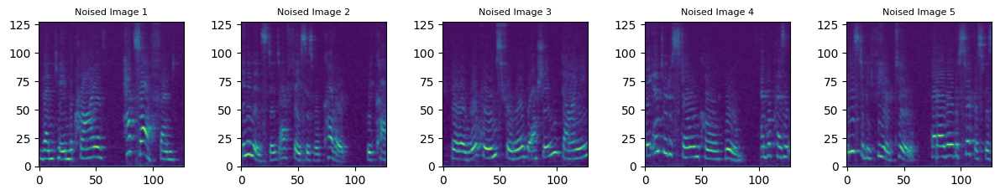

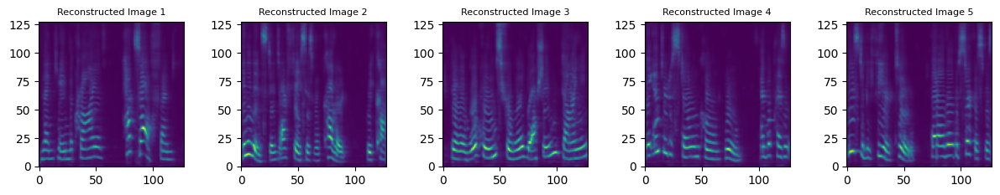

TRAIN - EPOCH 21/61 - loss: 0.2900
VALIDATION - EPOCH 21/61 - loss: 0.5639

--------------------------------------------------------------------------------
EPOCH 22/61
TRAIN - EPOCH 22/61 - loss: 0.2891
VALIDATION - EPOCH 22/61 - loss: 0.5870

--------------------------------------------------------------------------------
EPOCH 23/61
TRAIN - EPOCH 23/61 - loss: 0.2891
VALIDATION - EPOCH 23/61 - loss: 0.5654

--------------------------------------------------------------------------------
EPOCH 24/61
TRAIN - EPOCH 24/61 - loss: 0.2882
VALIDATION - EPOCH 24/61 - loss: 0.5497

--------------------------------------------------------------------------------
EPOCH 25/61
TRAIN - EPOCH 25/61 - loss: 0.2874
VALIDATION - EPOCH 25/61 - loss: 0.5580

--------------------------------------------------------------------------------
EPOCH 26/61
TRAIN - EPOCH 26/61 - loss: 0.2868
VALIDATION - EPOCH 26/61 - loss: 0.5569

-------------------------------------------------------------------------------

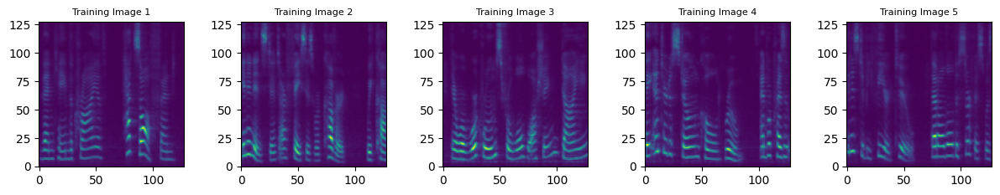

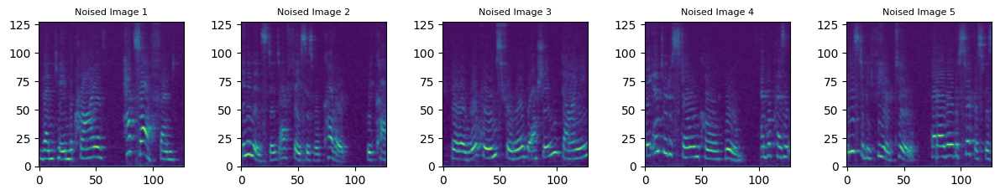

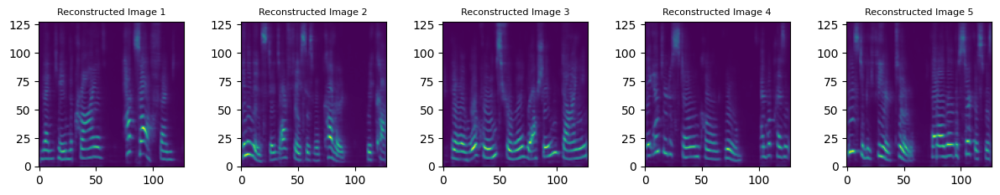

TRAIN - EPOCH 41/61 - loss: 0.2807
VALIDATION - EPOCH 41/61 - loss: 0.5164

--------------------------------------------------------------------------------
EPOCH 42/61
TRAIN - EPOCH 42/61 - loss: 0.2805
VALIDATION - EPOCH 42/61 - loss: 0.5254

--------------------------------------------------------------------------------
EPOCH 43/61
TRAIN - EPOCH 43/61 - loss: 0.2803
VALIDATION - EPOCH 43/61 - loss: 0.5101

--------------------------------------------------------------------------------
EPOCH 44/61
TRAIN - EPOCH 44/61 - loss: 0.2805
VALIDATION - EPOCH 44/61 - loss: 0.5115

--------------------------------------------------------------------------------
EPOCH 45/61
TRAIN - EPOCH 45/61 - loss: 0.2799
VALIDATION - EPOCH 45/61 - loss: 0.5114

--------------------------------------------------------------------------------
EPOCH 46/61
TRAIN - EPOCH 46/61 - loss: 0.2796
VALIDATION - EPOCH 46/61 - loss: 0.5112

-------------------------------------------------------------------------------

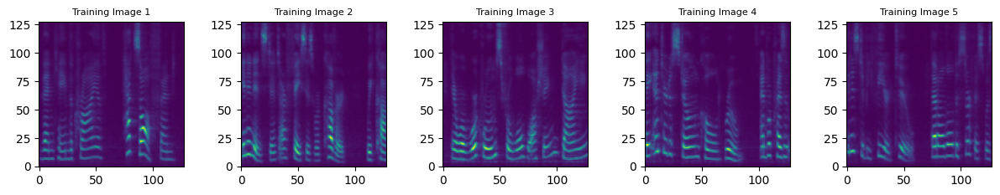

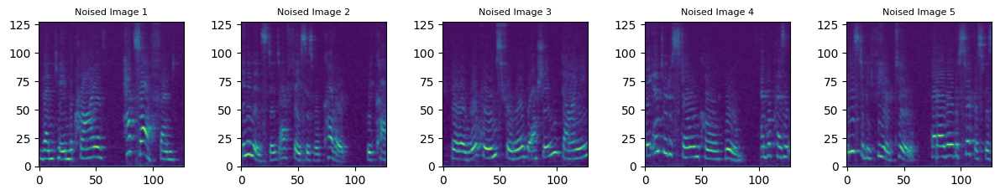

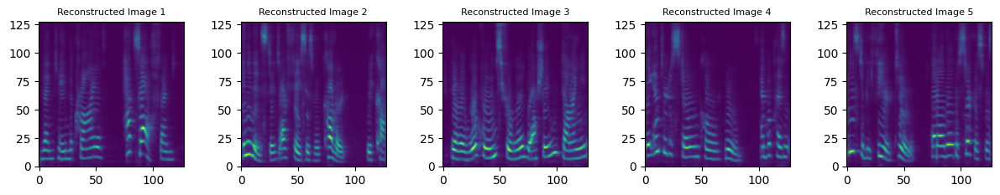

TRAIN - EPOCH 61/61 - loss: 0.2761
VALIDATION - EPOCH 61/61 - loss: 0.4978

--------------------------------------------------------------------------------
---- model type: B ----
Selected device: cuda
EPOCH 1/61


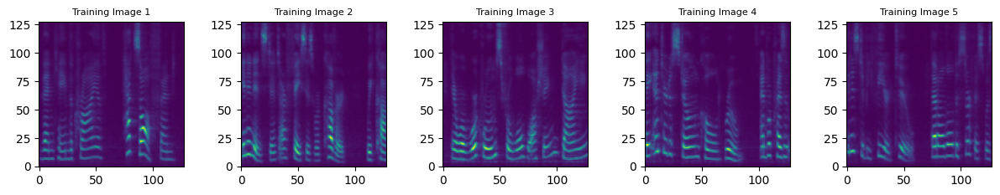

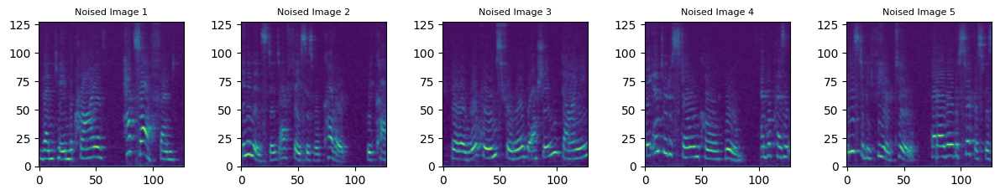

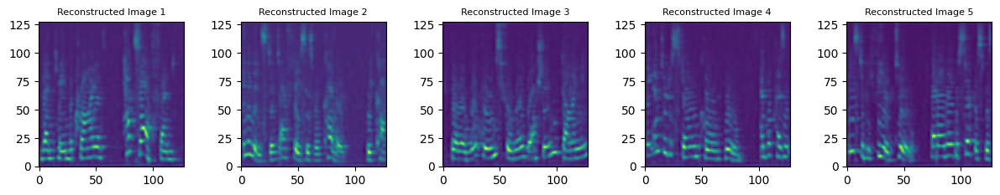

TRAIN - EPOCH 1/61 - loss: 0.4858
VALIDATION - EPOCH 1/61 - loss: 0.4600

--------------------------------------------------------------------------------
EPOCH 2/61
TRAIN - EPOCH 2/61 - loss: 0.3583
VALIDATION - EPOCH 2/61 - loss: 0.4724

--------------------------------------------------------------------------------
EPOCH 3/61
TRAIN - EPOCH 3/61 - loss: 0.3403
VALIDATION - EPOCH 3/61 - loss: 0.4674

--------------------------------------------------------------------------------
EPOCH 4/61
TRAIN - EPOCH 4/61 - loss: 0.3330
VALIDATION - EPOCH 4/61 - loss: 0.4672

--------------------------------------------------------------------------------
EPOCH 5/61
TRAIN - EPOCH 5/61 - loss: 0.3283
VALIDATION - EPOCH 5/61 - loss: 0.4724

--------------------------------------------------------------------------------
EPOCH 6/61
TRAIN - EPOCH 6/61 - loss: 0.3253
VALIDATION - EPOCH 6/61 - loss: 0.4733

--------------------------------------------------------------------------------
EPOCH 7/61
TRAI

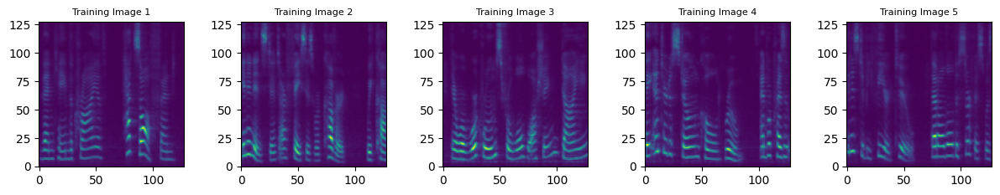

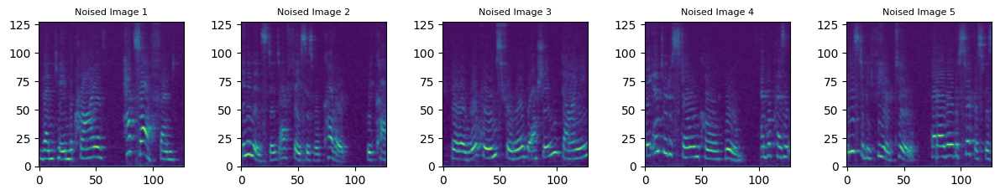

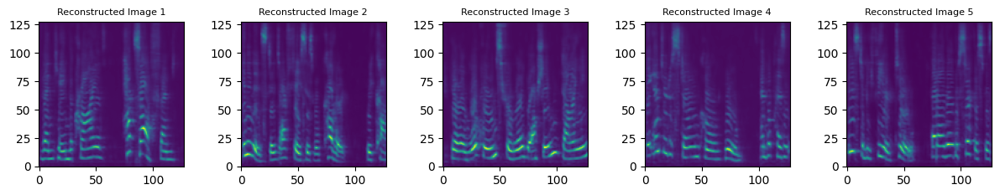

TRAIN - EPOCH 21/61 - loss: 0.3073
VALIDATION - EPOCH 21/61 - loss: 0.4728

--------------------------------------------------------------------------------
EPOCH 22/61
TRAIN - EPOCH 22/61 - loss: 0.3067
VALIDATION - EPOCH 22/61 - loss: 0.4754

--------------------------------------------------------------------------------
EPOCH 23/61
TRAIN - EPOCH 23/61 - loss: 0.3062
VALIDATION - EPOCH 23/61 - loss: 0.4774

--------------------------------------------------------------------------------
EPOCH 24/61
TRAIN - EPOCH 24/61 - loss: 0.3058
VALIDATION - EPOCH 24/61 - loss: 0.4758

--------------------------------------------------------------------------------
EPOCH 25/61
TRAIN - EPOCH 25/61 - loss: 0.3053
VALIDATION - EPOCH 25/61 - loss: 0.4743

--------------------------------------------------------------------------------
EPOCH 26/61
TRAIN - EPOCH 26/61 - loss: 0.3049
VALIDATION - EPOCH 26/61 - loss: 0.4760

-------------------------------------------------------------------------------

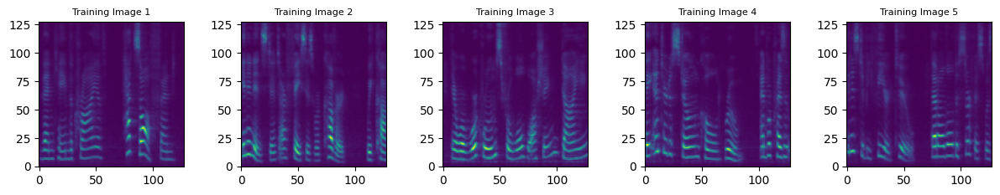

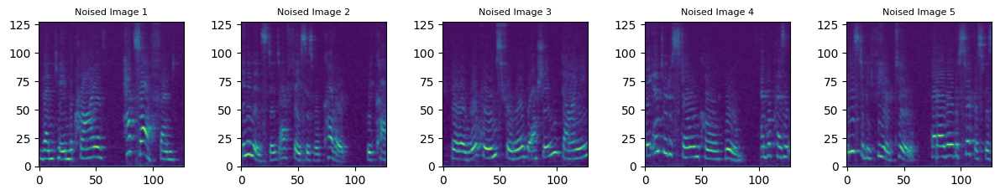

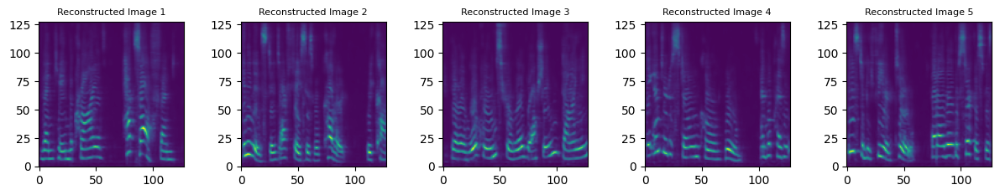

TRAIN - EPOCH 41/61 - loss: 0.3005
VALIDATION - EPOCH 41/61 - loss: 0.4641

--------------------------------------------------------------------------------
EPOCH 42/61
TRAIN - EPOCH 42/61 - loss: 0.3003
VALIDATION - EPOCH 42/61 - loss: 0.4642

--------------------------------------------------------------------------------
EPOCH 43/61
TRAIN - EPOCH 43/61 - loss: 0.3000
VALIDATION - EPOCH 43/61 - loss: 0.4617

--------------------------------------------------------------------------------
EPOCH 44/61
TRAIN - EPOCH 44/61 - loss: 0.3000
VALIDATION - EPOCH 44/61 - loss: 0.4663

--------------------------------------------------------------------------------
EPOCH 45/61
TRAIN - EPOCH 45/61 - loss: 0.2998
VALIDATION - EPOCH 45/61 - loss: 0.4645

--------------------------------------------------------------------------------
EPOCH 46/61
TRAIN - EPOCH 46/61 - loss: 0.2994
VALIDATION - EPOCH 46/61 - loss: 0.4630

-------------------------------------------------------------------------------

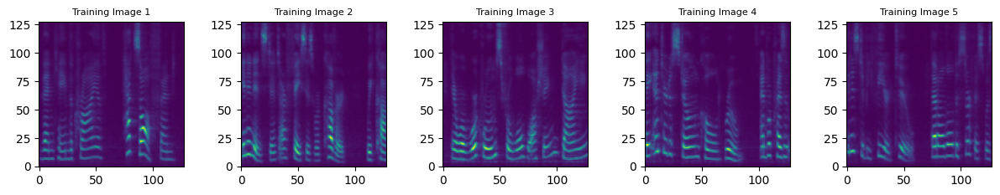

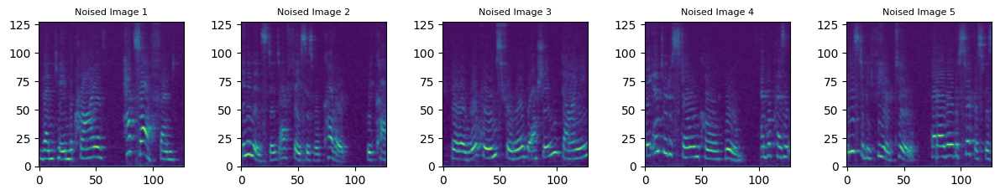

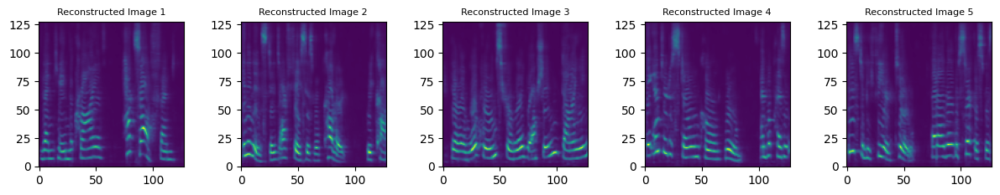

TRAIN - EPOCH 61/61 - loss: 0.2971
VALIDATION - EPOCH 61/61 - loss: 0.4499

--------------------------------------------------------------------------------
---- model type: C ----
Selected device: cuda
EPOCH 1/61


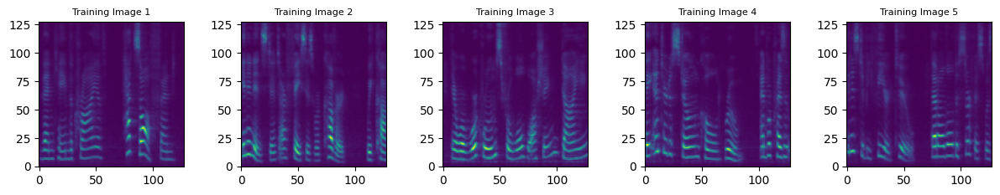

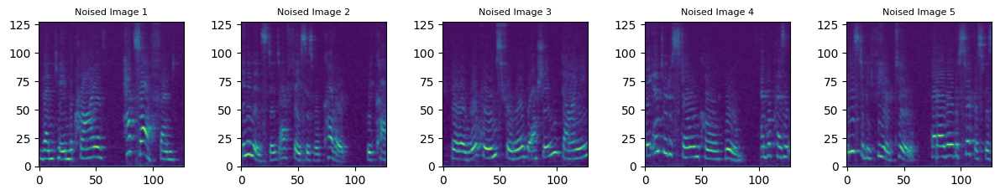

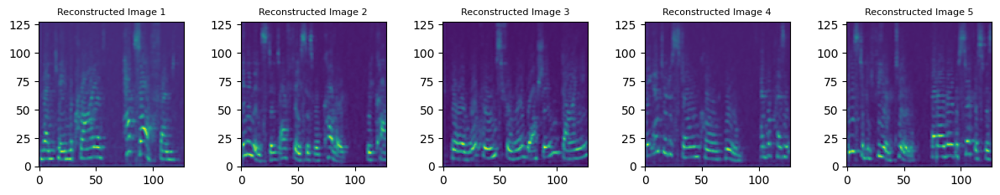

TRAIN - EPOCH 1/61 - loss: 0.4283
VALIDATION - EPOCH 1/61 - loss: 0.3864

--------------------------------------------------------------------------------
EPOCH 2/61
TRAIN - EPOCH 2/61 - loss: 0.3662
VALIDATION - EPOCH 2/61 - loss: 0.3664

--------------------------------------------------------------------------------
EPOCH 3/61
TRAIN - EPOCH 3/61 - loss: 0.3544
VALIDATION - EPOCH 3/61 - loss: 0.3594

--------------------------------------------------------------------------------
EPOCH 4/61
TRAIN - EPOCH 4/61 - loss: 0.3486
VALIDATION - EPOCH 4/61 - loss: 0.3558

--------------------------------------------------------------------------------
EPOCH 5/61
TRAIN - EPOCH 5/61 - loss: 0.3455
VALIDATION - EPOCH 5/61 - loss: 0.3540

--------------------------------------------------------------------------------
EPOCH 6/61
TRAIN - EPOCH 6/61 - loss: 0.3431
VALIDATION - EPOCH 6/61 - loss: 0.3521

--------------------------------------------------------------------------------
EPOCH 7/61
TRAI

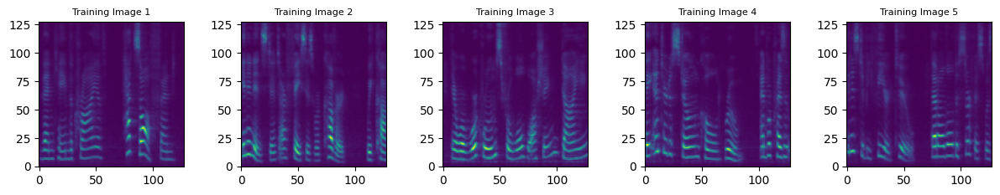

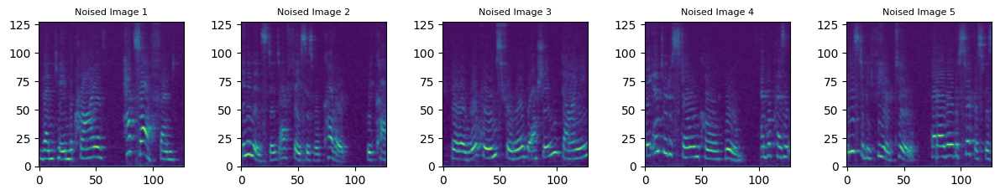

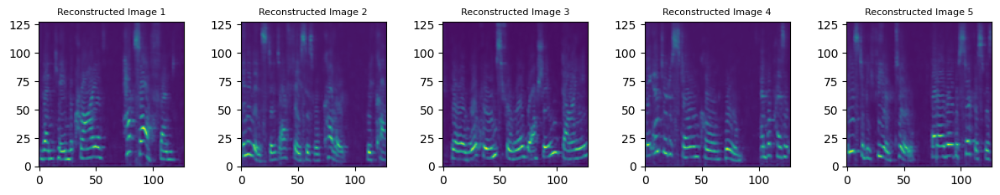

TRAIN - EPOCH 21/61 - loss: 0.3338
VALIDATION - EPOCH 21/61 - loss: 0.3431

--------------------------------------------------------------------------------
EPOCH 22/61
TRAIN - EPOCH 22/61 - loss: 0.3335
VALIDATION - EPOCH 22/61 - loss: 0.3427

--------------------------------------------------------------------------------
EPOCH 23/61
TRAIN - EPOCH 23/61 - loss: 0.3333
VALIDATION - EPOCH 23/61 - loss: 0.3424

--------------------------------------------------------------------------------
EPOCH 24/61
TRAIN - EPOCH 24/61 - loss: 0.3330
VALIDATION - EPOCH 24/61 - loss: 0.3419

--------------------------------------------------------------------------------
EPOCH 25/61
TRAIN - EPOCH 25/61 - loss: 0.3328
VALIDATION - EPOCH 25/61 - loss: 0.3417

--------------------------------------------------------------------------------
EPOCH 26/61
TRAIN - EPOCH 26/61 - loss: 0.3327
VALIDATION - EPOCH 26/61 - loss: 0.3415

-------------------------------------------------------------------------------

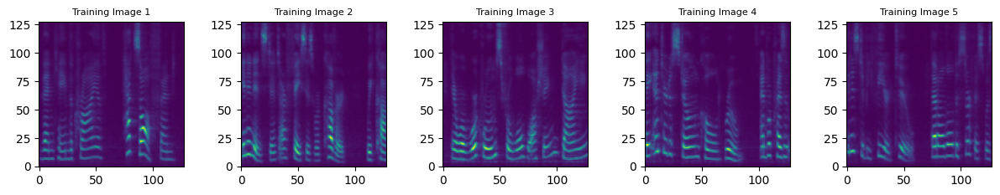

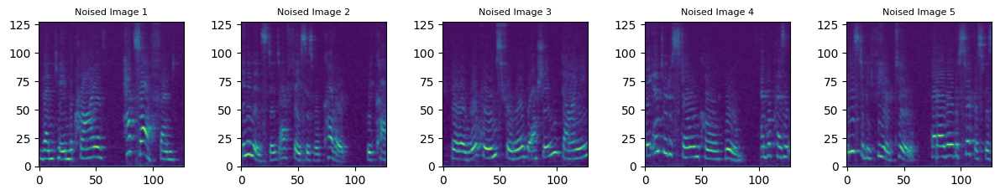

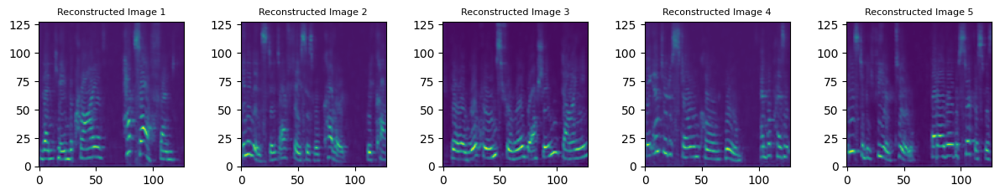

TRAIN - EPOCH 41/61 - loss: 0.3307
VALIDATION - EPOCH 41/61 - loss: 0.3388

--------------------------------------------------------------------------------
EPOCH 42/61
TRAIN - EPOCH 42/61 - loss: 0.3307
VALIDATION - EPOCH 42/61 - loss: 0.3387

--------------------------------------------------------------------------------
EPOCH 43/61
TRAIN - EPOCH 43/61 - loss: 0.3306
VALIDATION - EPOCH 43/61 - loss: 0.3388

--------------------------------------------------------------------------------
EPOCH 44/61
TRAIN - EPOCH 44/61 - loss: 0.3305
VALIDATION - EPOCH 44/61 - loss: 0.3386

--------------------------------------------------------------------------------
EPOCH 45/61
TRAIN - EPOCH 45/61 - loss: 0.3305
VALIDATION - EPOCH 45/61 - loss: 0.3385

--------------------------------------------------------------------------------
EPOCH 46/61
TRAIN - EPOCH 46/61 - loss: 0.3304
VALIDATION - EPOCH 46/61 - loss: 0.3385

-------------------------------------------------------------------------------

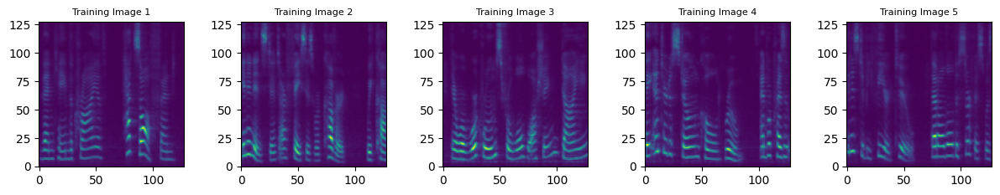

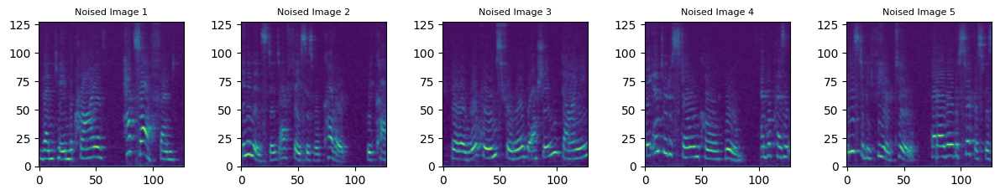

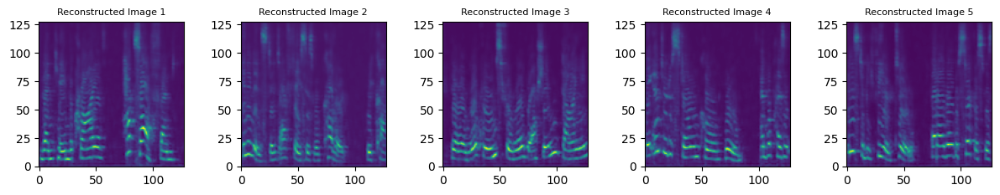

TRAIN - EPOCH 61/61 - loss: 0.3296
VALIDATION - EPOCH 61/61 - loss: 0.3381

--------------------------------------------------------------------------------


In [ ]:
encoderA, encoderB, encoderC = Encoder_A().to(device), Encoder_B().to(device), Encoder_C().to(device)
decoderA, decoderB, decoderC = Decoder_A().to(device), Decoder_B().to(device), Decoder_C().to(device)
encoders = [encoderA, encoderB, encoderC]
decoders = [decoderA, decoderB, decoderC]

model_types = ['A', 'B', 'C']
num_epochs = 61
training_curves_3, validation_curves_3 = np.zeros((3,num_epochs)), np.zeros((3,num_epochs))

for i, (encoder, decoder) in enumerate(zip(encoders, decoders)):
    print(f'---- model type: {model_types[i]} ----')

    ### Define the loss function
    err = 'SSIM'

    ### Define an optimizer (both for the encoder and the decoder!)
    lr = 5e-4 # Learning rate
    params_to_optimize = [
        {'params': encoder.parameters()},
        {'params': decoder.parameters(), "lr": 0.001}
    ]
    weight_decay = 1e-5
    optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=weight_decay)

    # Check if the GPU is available
    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    print(f'Selected device: {device}')

    # Move both the encoder and the decoder to the selected device
    encoder.to(device)
    decoder.to(device)


    T, V = [], []
    ### Training cycle
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))

        ### Training (use the training function)
        train_loss = train_epoch_3(
            encoder=encoder,
            decoder=decoder,
            device=device,
            dataloader=dataloader,
            dataloader_noised=dataloader_noised,
            optimizer=optim,
            k=epoch,
            weight_decay=weight_decay,
            err=err,
            visualize=True)
        print(f'TRAIN - EPOCH {epoch+1}/{num_epochs} - loss: {train_loss:.4f}')
        training_curves_3[i, epoch] = train_loss

        ### Validation  (use the testing function)
        val_loss = test_epoch_3(
            encoder=encoder,
            decoder=decoder,
            device=device,
            dataloader=test_dataloader,
            dataloader_noised=test_dataloader_noised,
            weight_decay=weight_decay,
            err=err)
        # Print Validationloss
        print(f'VALIDATION - EPOCH {epoch+1}/{num_epochs} - loss: {val_loss:.4f}\n')
        validation_curves_3[i, epoch] = val_loss.item()

        print('--------------------------------------------------------------------------------')

In [ ]:
training_curves_3_copy = training_curves_3.copy()
validation_curves_3_copy = validation_curves_3.copy()

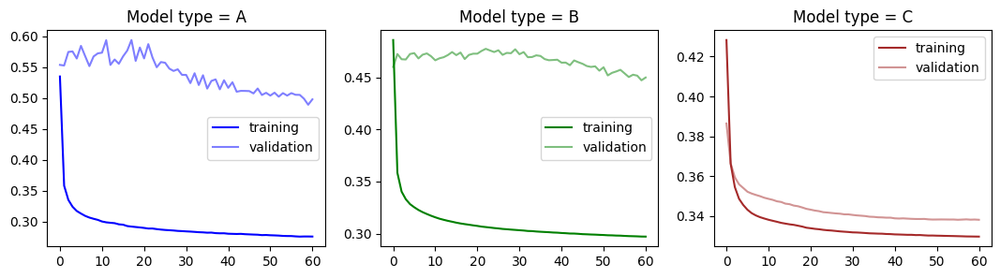

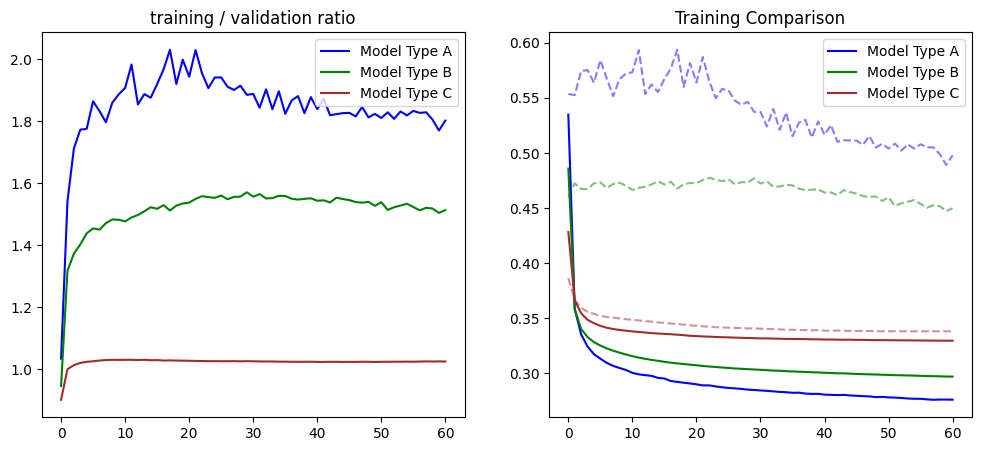

In [ ]:
ratios_curve_3 = []
colors = ['blue', 'green', 'brown']
fig, ax = plt.subplots(1, 3, figsize=(13, 3))
for i, model_type in enumerate(model_types):
    ratios_curve_3.append( validation_curves_3_copy[i] / training_curves_3_copy[i] )
    AX = ax[i]
    AX.set_title(f'Model type = {model_type}')
    AX.plot(training_curves_3_copy[i], c=colors[i], label=f'training')
    AX.plot(validation_curves_3_copy[i], c=colors[i], alpha=0.5, label=f'validation')
    AX.legend()
plt.show()

fig, ax = plt.subplots(1, 2, figsize=(12,5))
for j, r in enumerate(ratios_curve_3):
    ax[0].set_title(f'training / validation ratio')
    ax[0].plot(r, c=colors[j], label=f'Model Type {model_types[j]}')
    ax[1].set_title('Training Comparison')
    ax[1].plot(training_curves_3_copy[j], c=colors[j], label=f'Model Type {model_types[j]}')
    ax[1].plot(validation_curves_3_copy[j], linestyle='dashed', c=colors[j], alpha=0.5)
ax[0].legend()
ax[1].legend();

The above graphs indicate that by reducing the complexity of the models (i.e., decreasing the number of convolutional layers), two main consequences arise. On one hand, overfitting diminishes, evident in how the ratio between validation and training curves progressively decreases. On the other hand, there is a lower overall efficiency in audio cleaning, as demonstrated by the comparison of the training curves.

Trials with Training and Test Distorted Audio

> Training

In [ ]:
test_tensor = custom_dataset_noised[0].unsqueeze(0).to(device)
yo = librosa.feature.inverse.mel_to_audio((test_tensor**4).squeeze().cpu().detach().numpy())
print(f'Original Distrorted Audio')
display(Audio(yo, rate=22050))
yy = []
for i, (enc, dec) in enumerate(zip(encoders, decoders)):
    test_encoded = enc(test_tensor)
    test_decoded = dec(test_encoded)
    numpy_decoded = test_decoded.squeeze().cpu().detach().numpy()
    numpy_mel = numpy_decoded ** (4)
    y_decoded = librosa.feature.inverse.mel_to_audio(numpy_mel)
    yy.append(y_decoded)
    print(f'\nModel Type: {model_types[i]}')
    display(Audio(y_decoded, rate=22050))

Original Distrorted Audio



Model Type: A



Model Type: B



Model Type: C


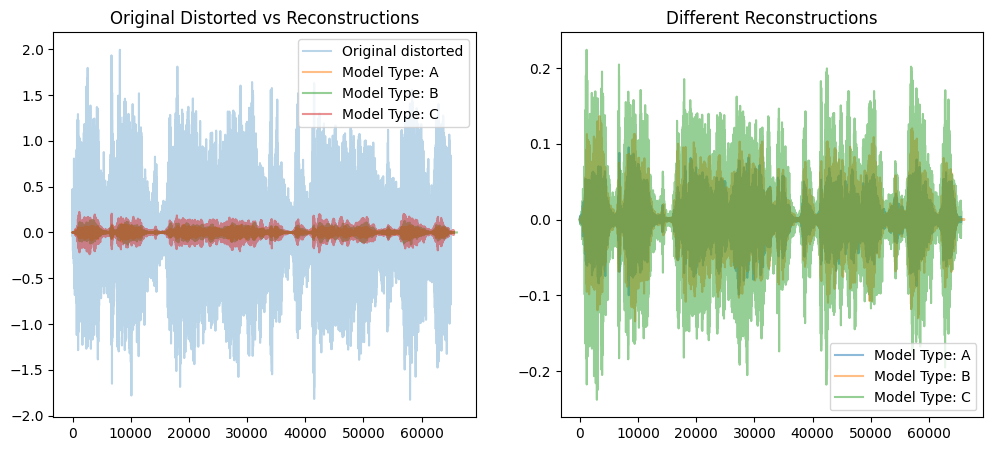

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(12,5))

ax[0].plot(yo, alpha=0.3, label='Original distorted')
for i in range(3):
  ax[0].plot(yy[i], alpha=0.5, label=f'Model Type: {model_types[i]}')
ax[0].set_title('Original Distorted vs Reconstructions')
ax[0].legend()

for i in range(3):
  ax[1].plot(yy[i], alpha=0.5, label=f'Model Type: {model_types[i]}')
ax[1].set_title('Different Reconstructions')
ax[1].legend();

> Test

In [ ]:
test_tensor = test_dataset_noised[20].unsqueeze(0).to(device)
yo = librosa.feature.inverse.mel_to_audio((test_tensor**4).squeeze().cpu().detach().numpy())
print(f'Original Distrorted Audio')
display(Audio(yo, rate=22050))

yy = []
for i, (enc, dec) in enumerate(zip(encoders, decoders)):
    test_encoded = enc(test_tensor)
    test_decoded = dec(test_encoded)
    numpy_decoded = test_decoded.squeeze().cpu().detach().numpy()
    numpy_mel = numpy_decoded ** (4)
    y_decoded = librosa.feature.inverse.mel_to_audio(numpy_mel)
    yy.append(y_decoded)
    print(f'\nModel Type: {model_types[i]}')
    display(Audio(y_decoded, rate=22050))

Original Distrorted Audio



Model Type: A



Model Type: B



Model Type: C


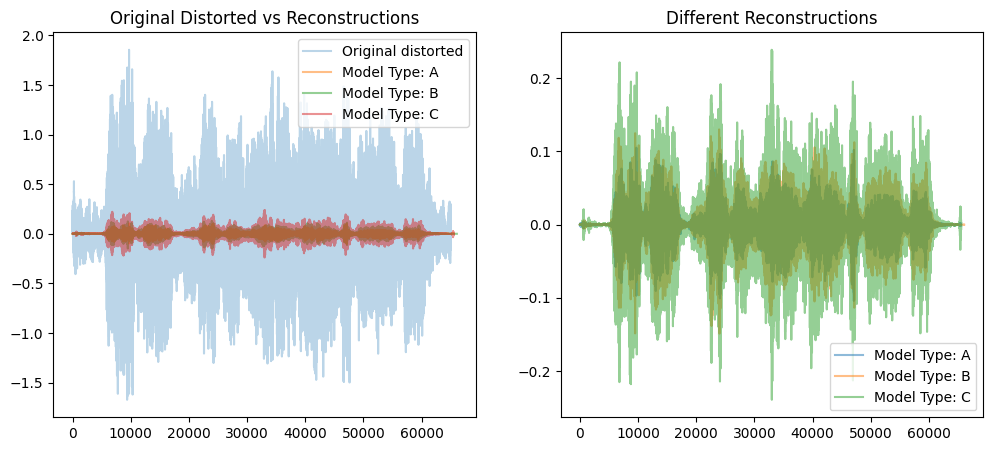

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(12,5))

ax[0].plot(yo, alpha=0.3, label='Original distorted')
for i in range(3):
  ax[0].plot(yy[i], alpha=0.5, label=f'Model Type: {model_types[i]}')
ax[0].set_title('Original Distorted vs Reconstructions')
ax[0].legend()

for i in range(3):
  ax[1].plot(yy[i], alpha=0.5, label=f'Model Type: {model_types[i]}')
ax[1].set_title('Different Reconstructions')
ax[1].legend();

In conclusion, we can observe and perceive that, thanks to the (slightly) improved handling of overfitting, even with a very basic model like type "C" (which has only one convolutional layer), we achieve a satisfactory level of cleanliness. It can be stated that all three models perform well in the task of noise removal, though subtle differences in quality restoration are perceptible among them.